In [6]:
import math
import random
from typing import Tuple
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import csv
random.seed(10)

In [2]:
import pickle
from pathlib import Path

# Structure: (theta, phi) -> (theta_etilt, phi_scan)
saved_tp = dict()
saved_tp_file = Path("t41p41.pkl")
if saved_tp_file.is_file():
    with open(saved_tp_file, "rb") as f:
        saved_tp = pickle.load(f)
        
# Structure: (segment, polygon) -> (boolean True or False)
saved_los = dict()

saved_los_file = Path("los41.pkl")
if saved_los_file.is_file():
    with open(saved_los_file, "rb") as f:
        saved_los = pickle.load(f)

In [3]:
!pip install Geometry3D shapely

In [4]:
from Geometry3D import *
from shapely import geometry

In [5]:
data = pd.read_csv("C:\\Users\\tniloy\\Downloads\\opencellid dataset\\310.csv", names=['radio', 'mcc', 'mnc', 'lac', 'cid', 'unit', 'longitude', 'latitude', 'range', 'samples', 'changeable', 'created', 'updated', 'averageSignal'])

In [6]:
data.head (10)

,radio,mcc,mnc,lac,cid,unit,longitude,latitude,range,samples,changeable,created,updated,averageSignal
0,GSM,310,260,32192,22568,0,-73.858566,40.898438,1779,12,1,1459696254,1489125559,0
1,GSM,310,260,22629,61562,0,-95.876501,41.286475,3367,17,1,1459810860,1609205988,0
2,GSM,310,260,51052,44152,0,-71.084483,42.381728,1000,44,1,1459812328,1514115939,0
3,GSM,310,260,51051,40311,0,-71.085559,42.381356,1000,52,1,1459812328,1527695374,0
4,GSM,310,260,5973,60092,0,-95.570630,29.735371,1000,22,1,1459692332,1490851584,0
5,GSM,310,410,19007,7133,0,-87.258205,40.153886,19135,6,1,1459699529,1472415099,0
6,GSM,310,410,53005,50671,0,-95.563889,30.280380,1000,1,1,1459775023,1459775023,0
7,GSM,310,260,46136,15418,0,-76.999741,39.160080,1000,1,1,1459663271,1459663271,0
8,GSM,310,410,27672,59021,0,-81.741964,26.213691,1000,11,1,1459687298,1491031828,0
9,GSM,310,260,5973,50942,0,-95.560226,29.736557,1000,6,1,1459692332,1469493454,0


In [7]:
# center_x = 0
# center_y = 0
# center_z = 0
# FSS POsition:
lat_FSS= 37.20250
lon_FSS= -80.43444
R  = 6.371e6  #Radius of the earth

x_FSS = R * math.cos(math.radians(lat_FSS)) * math.cos(math.radians(lon_FSS))
y_FSS = R * math.cos(math.radians(lat_FSS)) * math.sin(math.radians(lon_FSS))
z_FSS = R * math.sin(math.radians(lat_FSS))

print("X, Y, Z = "+ str([x_FSS, y_FSS, z_FSS]))


radius=5000 #radius of the inclusion zone
latitude_range = radius / 110574
longitude_range = radius/(111320*math.cos(math.radians(latitude_range)))
print("Total area of inclusion zone is = " + str(radius*radius*math.pi))

X, Y, Z = [843264.3231973607, -5003968.368478095, 3852122.3823358943]
Total area of inclusion zone is = 78539816.33974482


In [8]:
print(latitude_range)
print(longitude_range)

0.04521858664785573
0.044915572737550945


In [9]:
data_within_zone = data[(data['radio'] == 'GSM') & (data['longitude'] <= (lon_FSS + longitude_range)) & (data['longitude'] >= (lon_FSS - longitude_range)) & (data['latitude'] <= (lat_FSS + latitude_range)) & (data['latitude'] >= (lat_FSS - latitude_range))]

data_within_zone.head(10)


,radio,mcc,mnc,lac,cid,unit,longitude,latitude,range,samples,changeable,created,updated,averageSignal
780410,GSM,310,260,37630,43582,0,-80.393175,37.196127,8733,3992,1,1413757287,1435049916,0
1813932,GSM,310,260,32453,43561,0,-80.421524,37.189560,1000,9,1,1458834001,1491931840,0
1813934,GSM,310,260,32453,43602,0,-80.410309,37.233810,1000,6,1,1458834001,1479555225,0
1814053,GSM,310,260,32453,43822,0,-80.406704,37.227516,1000,8,1,1458834001,1479576548,0
1814075,GSM,310,260,32453,43583,0,-80.461073,37.203233,2207,15,1,1458834001,1477155991,0
1814213,GSM,310,260,32453,43581,0,-80.409897,37.217972,1000,5,1,1458834001,1473235293,0
1814220,GSM,310,260,32453,43601,0,-80.425186,37.236099,1000,6,1,1458834001,1473191254,0
1814361,GSM,310,260,32453,43562,0,-80.391645,37.165063,1000,11,1,1458834001,1489446412,0
1814366,GSM,310,260,32453,43603,0,-80.425415,37.222710,1000,4,1,1458834001,1474352285,0
1814368,GSM,310,260,32453,43621,0,-80.393486,37.224279,1033,56,1,1458834001,1482422269,0


In [10]:
len(data_within_zone)

33

In [11]:
import json
with open ('C:\\Users\\tniloy\\Downloads\\export (1).geojson') as f:
    df=json.load(f)
    data1=pd.json_normalize(df,record_path=['features'])
data1.head(10)

,type,id,properties.@id,properties.addr:housenumber,properties.addr:street,properties.building,properties.height,properties.name,properties.operator,properties.type,...,properties.automatic_door,properties.access,properties.button_operated,properties.door,properties.operator:short,properties.operator:type,properties.operator:wikidata,properties.operator:wikipedia,properties.foot,properties.vehicle
0,Feature,relation/308029,relation/308029,630,Washington Street Southwest,dormitory,15.7,Pritchard Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Feature,relation/548333,relation/548333,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Feature,relation/548339,relation/548339,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Feature,relation/548344,relation/548344,1406,Giles Road,church,NaN,Blacksburg First Wesleyan Church,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Feature,relation/548347,relation/548347,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,Feature,relation/548348,relation/548348,NaN,NaN,residential,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,Feature,relation/548371,relation/548371,1416,Palmer Drive,detached,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,Feature,relation/548372,relation/548372,900,Dickerson Lane,detached,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,Feature,relation/548373,relation/548373,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,Feature,relation/548386,relation/548386,NaN,NaN,yes,NaN,NaN,NaN,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [12]:
data1[data1["properties.height"].notnull()].head(20)

,type,id,properties.@id,properties.addr:housenumber,properties.addr:street,properties.building,properties.height,properties.name,properties.operator,properties.type,...,properties.automatic_door,properties.access,properties.button_operated,properties.door,properties.operator:short,properties.operator:type,properties.operator:wikidata,properties.operator:wikipedia,properties.foot,properties.vehicle
0,Feature,relation/308029,relation/308029,630,Washington Street Southwest,dormitory,15.7,Pritchard Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
33,Feature,relation/1360465,relation/1360465,NaN,NaN,university,14.86,East Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
34,Feature,relation/1360466,relation/1360466,NaN,NaN,dormitory,14.86,West Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
35,Feature,relation/1360467,relation/1360467,NaN,NaN,dormitory,11.27,Slusher Wing,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
36,Feature,relation/1360468,relation/1360468,NaN,NaN,dormitory,33.59,Slusher Tower,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
37,Feature,relation/1360469,relation/1360469,NaN,NaN,dormitory,14.86,Main Eggleston Hall,Virginia Tech,multipolygon,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
66,Feature,way/26210227,way/26210227,NaN,NaN,university,15.47,Cheatham Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
67,Feature,way/26210236,way/26210236,285,Ag Quad Lane,university,11.57,Dietrick Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
69,Feature,way/32709325,way/32709325,570,Washington Street Southwest,dormitory,25.82,Hoge Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
98,Feature,way/32953606,way/32953606,210,Drillfield Drive,university,11.61,Sandy Hall,Virginia Tech,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [13]:
data1["geometry.coordinates"].head(10)

0    [[[-80.4194702, 37.2238774], [-80.4194505, 37....
1    [[[-80.4070717, 37.2320238], [-80.4069865, 37....
2    [[[-80.4068521, 37.2319488], [-80.4069373, 37....
3    [[[-80.4104274, 37.2506844], [-80.4104412, 37....
4    [[[-80.4355296, 37.2138316], [-80.4355103, 37....
5    [[[-80.4416012, 37.2238365], [-80.4417281, 37....
6    [[[-80.3924701, 37.2185727], [-80.3923812, 37....
7    [[[-80.4121293, 37.2397986], [-80.4121648, 37....
8    [[[-80.4075916, 37.2253453], [-80.4076676, 37....
9    [[[-80.4071473, 37.2322051], [-80.4072218, 37....
Name: geometry.coordinates, dtype: object

In [14]:
class Building:
    def __init__(self, coordinates=None, height=None):
        self.coordinates = []
        if coordinates is not None:
            self.coordinates = coordinates
        
        if height is None or not str(height).isdigit():
            self.height = random.uniform(10, 40)
        else:
            self.height = height
        
        self.x_coord, self.y_coord, self.z_coord = self.latlon_to_XYZ()
        
        self.points = []
        for i in range(len(self.x_coord)):
            x, y, z = self.x_coord[i], self.y_coord[i], self.z_coord[i]
            self.points.append(Point(x,y,z))
        
        self.xy_points = np.array([(p.x, p.y) for p in self.points])
        self.xy_polygon = geometry.Polygon(self.xy_points)
        
        self.wall_polygons = self.get_wall_polygons()
    
    def latlon_to_XYZ(self):
        x_coord = np.array([])
        y_coord = np.array([])
        z_coord = np.array([])
        
        # bottom points of building at each coordinate
        for lon, lat in self.coordinates:
            x = R * math.cos(math.radians(lat)) * math.cos(math.radians(lon))
            y = R * math.cos(math.radians(lat)) * math.sin(math.radians(lon))
            x_coord = np.append(x_coord, x)
            y_coord = np.append(y_coord, y)
            z_coord = np.append(z_coord, 0)
            # z_coord = np.append(z_coord, self.height)
            
        # make coordinates to relative to FSS position
        x_coord -= x_FSS
        y_coord -= y_FSS
        
        return x_coord, y_coord, z_coord

    def get_wall_polygons(self):
        polygons = []

        # points = [Point(x,y,0) for x,y in p.boundary.coords]
        # polygons.append(ConvexPolygon(points))
        points = [Point(x,y,self.height) for x,y in self.xy_polygon.boundary.coords]
        # polygons.append(ConvexPolygon(points))

        for i in range(len(points)-1):
            high_point_1 = points[i]
            high_point_2 = points[i + 1]
            low_point_1 = Point(high_point_1.x, high_point_1.y, 0)
            low_point_2 = Point(high_point_2.x, high_point_2.y, 0)

            poly_points = [low_point_1, low_point_2, high_point_1, high_point_2]
            #print(poly_points)
            polygons.append(ConvexPolygon(poly_points))
            
        return polygons
        

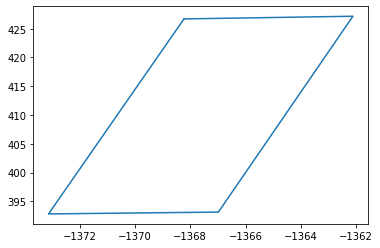

In [15]:
from shapely import geometry

b = Building(data1.iloc[500]["geometry.coordinates"][0], data1.iloc[500]["properties.height"])
x, y = b.xy_polygon.boundary.xy
plt.plot(x, y)

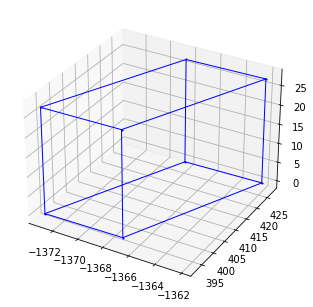

In [16]:
r = Renderer(backend='matplotlib')
for p in b.wall_polygons:
    r.add((p,'b',1),normal_length=0)
r.show()

In [17]:
from tqdm import tqdm
buildings = []

for i in tqdm(range(len(data1))):
    for coords in data1.iloc[i]["geometry.coordinates"]:
        try:
            buildings.append(Building(coords, data1.iloc[i]["properties.height"]))
        except:
            print(f"Skipping building {i}")

  1%|▌                                                                              | 68/8644 [00:00<00:40, 211.71it/s]

Skipping building 26
Skipping building 26
Skipping building 27
Skipping building 27
Skipping building 27
Skipping building 28
Skipping building 28
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 29
Skipping building 53
Skipping building 53
Skipping building 53
Skipping building 53


100%|█████████████████████████████████████████████████████████████████████████████| 8644/8644 [00:16<00:00, 525.34it/s]

Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8165
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8166
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8167
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8168
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8169
Skipping building 8170
Skipping building 8170
Skipping building 8170
Skipping bu

In [18]:
class FSS_Channels:
  # channels start at 0, so a channel plan with 8 channels is from 0 to 7

  band_width = 240e6 # 240MHz

  # 10.7-12.7 GHz frequency range
  range_start = 10.7e9 # 10.7GHz
  range_end = 12.7e9 # 12.7GHz

  channel_count = 8

  range_size = range_end - range_start
  unused_space = range_size - band_width * channel_count

  # FSS channel spacing should be 10MHz
  space_between_channels = unused_space / channel_count

  @staticmethod
  def getChannelRange(channel) -> Tuple[int, int]:
    channel_start = int((0.5 + channel) * FSS_Channels.space_between_channels + channel * FSS_Channels.band_width)
    channel_end = channel_start + FSS_Channels.band_width
    return channel_start, channel_end

  def __init__(channel):
    self.channel = channel

In [19]:
class BS_Channels:
  # channels start at 1, so a channel plan with 5 channels is from 1 to 5

  band_width = 100e6 # 100MHz

  # 12.2-12.7 GHz frequency range
  range_start = 12.2e9 # 12.2GHz
  range_end = 12.7e9 # 12.7GHz

  channel_count = 5

  range_size = range_end - range_start
  unused_space = range_size - band_width * channel_count

  # BS channel spacing should be 0MHz
  space_between_channels = unused_space / channel_count

  @staticmethod
  def getChannelRange(channel) -> Tuple[int, int]:
    channel -= 1
    
    channel_start = int((0.5 + channel) * BS_Channels.space_between_channels + channel * BS_Channels.band_width)
    channel_end = channel_start + BS_Channels.band_width
    return channel_start, channel_end

  def __init__(channel):
    self.channel = channel

In [20]:
def path_loss_UMi(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##UMi
##LOS,SF=4:

##(10m<=d_2D)<=D_BP:
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+((FSS_Y-BS_Y)**2)+((4.5-10)**2))
    hBs=10
    fc=12
    d_3D=math.sqrt(hBs**2+d_2D**2)
    PL1umi=32.4+21*math.log10(d_3D)+20*math.log10(fc)
    
##(D_BP<=d_2D)<=5000m:
    hBs=10
    hUT=4.5
    hE=1
    hBs1=hBs-hE
    hUT1=hUT-hE
    c=3e8
    D_BP= (4*hBs1*hUT1*12e9)/c
    PL2umi=32.4+40*math.log10(d_3D)+20*math.log10(fc)-9.5*math.log10((D_BP)**2+(hBs-hUT)**2)
    
    if 10 <=d_2D and d_2D<=D_BP:
        PLUMiLOS=PL1umi
    elif D_BP<=d_2D and  d_2D<=5000:
        PLUMiLOS= PL2umi  
    else:
        PLUMiLOS=1

##NLOS,SF=7.82:
    PL1umiNLOS= 35.3*math.log10(d_3D)+22.4+21.3*math.log10(fc)-0.3*(hUT-1.5)
    PLUMiNLOS= max(PLUMiLOS,PL1umiNLOS)
    
    line_of_sight = True
    
##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, 10), Point(FSS_X, FSS_Y, 4.5))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_UMi = PLUMiNLOS
                    line_of_sight = False
                else:
                    path_loss_UMi = PLUMiLOS
#                     line_of_sight = True
    
 # intersection(line, polygon): [Intersection], None
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_UMi = PLUMiNLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_UMi = PLUMiLOS
#                 line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False
    
# #Loss Probability:
#     if d_2D>18:
#         PrLosUmi=(18/d_2D)+math.exp((-(d_2D/36))*(1-(18/d_2D)))     
#     else:
#         PrLosUmi=1 ##d_2d<=18     
#     if PrLosUmi > random.random():
#         path_loss_UMi = PLUMiLOS   
#     else:
#         path_loss_UMi = PLUMiNLOS   
##path_loss 
#     path_loss_UMi= PL2umi*PrLosUmi+PL1umiNLOS*(1-PrLosUmi)
    
    return path_loss_UMi, d_2D, line_of_sight

In [21]:
def path_loss_UMa(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##LOS,SF=4:
##(10m<=d_2D)<=D_BP:
    fc=12
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+(FSS_Y- BS_Y)**2)+((FSS_Z-BS_Z)**2)
    hBs=25
    d_3D=math.sqrt(hBs**2+d_2D**2)
    PL3uma=28.0+22*math.log10(d_3D)+20*math.log10(fc)
    
##(D_BP<=d_2D) <=5000m:
    hUT=1.5
    hE=1
    hBs1=hBs-hE
    hUT1=hUT-hE
    c=3e8
    D_BP= (4*hBs1*hUT1*12e9)/c
    PL4uma=28.0+40*math.log10(d_3D)+20*math.log10(fc)-9*math.log10((D_BP)**2+(hBs-hUT)**2)
    
    if 10 <=d_2D and d_2D<=D_BP:
        PLUMALOS=PL3uma
    elif D_BP<=d_2D and d_2D<=5000:
         PLUMALOS= PL4uma  
    else:
        PLUMALOS=1
        
##NLOS,SF=6:
    PL1NLOSuma=13.54+39.08*math.log10(d_3D)+20*math.log10(fc)-0.6*(hUT-1.5)
    PLUMANLOS=max(PLUMALOS,PL1NLOSuma)
    
    line_of_sight = True

##NLOS,SF=7.8 (optional)
##PL_Optional=32.4+20*math.log(fc)+30*math.log(d_3D)


##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, BS_Z), Point(FSS_X, FSS_Y, FSS_Z))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_UMa = PLUMANLOS
                    line_of_sight = False
                else:
                    path_loss_UMa = PLUMALOS
#                     line_of_sight = True
                
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_UMa = PLUMANLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_UMa = PLUMALOS
#                 line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False


##Loss Probability:
#     if d_2D >18:
#         if hUT<=13:
#             ChUT=0
#         elif 13<hUT and hUT<=23:
#             ChUT=((hUT-13)/10)**1.5  
#         PrLOSUma=((18/d_2D)+math.exp((-(d_2D/63))*(1-(18/d_2D))))*(1+ChUT*(5/4)*((d_2D/100)**3)*math.exp(-(d_2D/150)))
#     else:##18m<d_2D:
#         PrLOSUma=1
        
#     if PrLOSUma > random.random():
#         path_loss_UMa = PLUMALOS
    
#     else:
#         path_loss_UMa = PLUMANLOS
    
##Path Loss
#     path_loss_UMa= PL4uma*PrLOSUma+PL1NLOSuma*(1-PrLOSUma)
    return path_loss_UMa, d_2D, line_of_sight

In [22]:
def path_loss_RMa(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z):
##LOS,SF=4(PL1),SF=6(PL2)
##10m<=d_2D<=d_BP: 
    fc=12
    h=5
    d_2D=math.sqrt(((FSS_X-BS_X)**2)+((FSS_Y- BS_Y)**2)+((FSS_Z-BS_Z)**2))
    hBs=35
    d_3D= math.sqrt(hBs**2+d_2D**2)
    PL1rma=20*math.log10((40*math.pi*d_3D*fc)/3)+ min(0.03*h**1.72,10)*math.log10(d_3D)-min(0.044*h**1.72,14.77)+0.002*math.log10(h)*d_3D
    
##d_BP<=d_2D<=10km:
    hUT=1.5
    c=3e8
    d_BP= (2*math.pi*hBs*hUT*12e9)/c
    PL2rma= PL1rma*(d_BP)+40*math.log10(d_3D/d_BP)

    if 10<=d_2D and d_2D <=d_BP:
        PLRMALOS=PL1rma
    elif d_BP<=d_2D and d_2D <=10000:
        PLRMALOS= PL2rma  
    else:
        PLRMALOS=1

##NLOS,SF=8:
    W=20
    h=5
    PL1NLOSrma= 161.04-7.11*math.log10(W)+7.5*math.log10(h)-(24.37-3.7*(h/hBs)**2)*math.log10(hBs)+(43.42-3.1*math.log10(hBs))*(math.log10(d_3D)-3)+20*math.log10(fc)-(3.2*(math.log10(11.75*hUT))**2-4.97)
    PLRMANLOS=max(PLRMALOS,PL1NLOSrma)
    
    line_of_sight = True
    
##realistic pathloss:
    bs_to_fss_segment = Segment(Point(BS_X, BS_Y, BS_Z), Point(FSS_X, FSS_Y, FSS_Z))
    for i in tqdm(range(len(buildings))):
#     for i in range(len(buildings)):
        for polygon in buildings[i].wall_polygons:
            if (hash(bs_to_fss_segment), hash(polygon)) in saved_los:
                if saved_los.get((hash(bs_to_fss_segment), hash(polygon))):
                    path_loss_RMa = PLRMANLOS
                    line_of_sight = False
                else:
                    path_loss_RMa = PLRMALOS
                    # line_of_sight = True
   
            elif intersection(bs_to_fss_segment, polygon) is not None:
                path_loss_RMa = PLRMANLOS
                line_of_sight = False
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = True
            else:
                path_loss_RMa = PLRMALOS
                # line_of_sight = True
                saved_los[(hash(bs_to_fss_segment), hash(polygon))] = False
                
    

# ##Loss Probability:
#     if d_2D>10:
#         PrLOSrma=math.exp(-((d_2D-10)/1000))
        
# ## 10m<d_2D:
#     else:
#         PrLOSrma=1
        
#     if PrLOSrma > random.random():
#         path_loss_RMa= PLRMALOS
    
#     else:
#         path_loss_RMa = PLRMANLOS

##PathLoss:
#     path_loss_RMa=PL2rma*PrLOSrma+PL1NLOSrma*(1-PrLOSrma)
    return path_loss_RMa, d_2D,  line_of_sight

In [23]:
def Interface_UMi_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_UMi,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        # theta_tilt, phi_scan = max_gain_5g_parameters(theta, phi)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, (10-4.5)

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
#         print("Angle between interference axis and FSS main lobe:", fss_phi_difference)
        if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)

#         G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)

        TXPower= 8
#         LBuildingLoss=1
        interface1=TXPower+ 0-pathloss_UMi- LBodyLoss + G_Rx_5G 
        return interface1,pathloss_UMi

In [24]:
def Interface_UMa_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_UMa,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, BS_Z-FSS_Z

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)

#         G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)
        
        TXPower= 8
#         LBuildingLoss=1
        interface2=TXPower+ 0-pathloss_UMa- LBodyLoss + G_Rx_5G
        return interface2,pathloss_UMa
    

In [25]:
def Interface_RMa_1(BS_X,BS_Y,BS_Z,FSS_X,FSS_Y,FSS_Z,FSS_phi,pathloss_RMa,theta_tilt,phi_scan,output=False):
        LBodyLoss=4
#         LSpectralOverlap=10*math.log(10)
        x, y, z = BS_X-FSS_X, BS_Y-FSS_Y, BS_Z-FSS_Z

        theta_bs_es = math.degrees(math.atan(y/x)) % 360
        phi_bs_es = math.degrees(math.sqrt(x**2 + y**2) / z) % 360
        # if output: print("theta_bs_es:", theta_bs_es, "phi_bs_es:", phi_bs_es)
        fss_phi_difference = abs(FSS_phi - phi_bs_es)
        if output: print("fss_phi_difference:", fss_phi_difference)

#         G_5G_R=gain_5g(theta_bs_es, phi_bs_es, theta_tilt, phi_scan)
        G_Rx_5G=gain_fss_wbes_b(fss_phi_difference)
        
        TXPower= 8
#         LBuildingLoss=1
        interface3=TXPower+ 0-pathloss_RMa-LBodyLoss + G_Rx_5G
        return interface3,pathloss_RMa

In [26]:
k = 1.38064852*10**(-23)
T=200
B=240e6
Noise = 10*math.log10(k*T*B)
Noise_W = 10 ** (Noise / 10)
print('Noise:', Noise)
print('Noise in Watts:', Noise_W)

Noise: -121.78675630934148
Noise in Watts: 6.627112895999999e-13


In [27]:
bs_ue_max_radius = 1000
bs_ue_min_radius= 1
base_station_count=33

# fss1 = BS(radius, max_height=1.5, carr_freq=12e9, interference_type=None)
x,y,z = 0,0,4.5

FSS_phi = {
    'UMi': 15,
    'UMa': 48,
    'RMa': 5
}

exclusion_zones = [500, 1000, 2000, 3000, 4000]
        
def simulate(output=True):
    FSS_X=np.array([])
    FSS_Y=np.array([])
    FSS_Z=np.array([])
    FSS_CHANNELS = []
    for i in range (1):
        FSS_X = np.append(FSS_X, x)
        FSS_Y = np.append(FSS_Y, y)
        FSS_Z = np.append(FSS_Z, 4.5)
        # 0 means not in use, 1 means in use
        channel_status = [random.randint(0, 1) for i in range(FSS_Channels.channel_count)]
        channels_used = np.array([i for i in range(FSS_Channels.channel_count) if channel_status[i] == 1])
        FSS_CHANNELS.append(channels_used)
        if output: print("FSS Co-ordinates=" +str (x)+ "," + str(y)+ "," + str(z) + ", channel: " + str(channels_used))
    if output: print(FSS_X, FSS_Y, FSS_Z, FSS_CHANNELS)

    # Create base stations
    BS_X=np.array([])
    BS_Y=np.array([])
    BS_Z=np.array([])
    
    # Randomly select base stations 
    # base_station_indexes = random.sample(range(len(data_within_zone)), base_station_count)

    # for i in base_station_indexes:
    for i in range(base_station_count):
        lat_BS, lon_BS = data_within_zone.iloc[i]['latitude'], data_within_zone.iloc[i]['longitude']
#         bs1 = BS(radius, max_height=35, carr_freq=12e9, interference_type=None)
        x_BS = R * math.cos(math.radians(lat_BS)) * math.cos(math.radians(lon_BS))
        y_BS = R * math.cos(math.radians(lat_BS)) * math.sin(math.radians(lon_BS))
#         z_BS = R * math.sin(math.radians(lat_BS))

        BS_X = np.append(BS_X, x_BS - x_FSS)
        BS_Y = np.append(BS_Y, y_BS - y_FSS)
        BS_Z = np.append(BS_Z, 0)
        if output: print("Bs Co-ordinates=" +str (x_BS)+ "," + str(y_BS)+ "," + str(z_BS))
    
    if output: print(BS_X,BS_Y,BS_Z)

    # Create user equipment
    UE_X=np.array([])
    UE_Y=np.array([])
    UE_Z=np.array([])
    UE_CHANNEL=np.array([])
    for p in range (len(BS_X)):
        for i in range(3):
    # number of split regions
    # i is the sector number
            for j in range(10):
      # number of UEs per region
      # j is the number of the UE in one sector
                bs_x, bs_y, bs_z = BS_X[p], BS_Y[p],BS_Z[p]
                theta_bs_ue = random.uniform(120 * i, 120 * (i+1))
                # 0-120, 120-240, 240-360
                radius_bs_ue = random.uniform(bs_ue_min_radius, bs_ue_max_radius)

                x1 = bs_x + radius_bs_ue * math.cos(math.radians(theta_bs_ue))
                y1 = bs_y + radius_bs_ue * math.sin(math.radians(theta_bs_ue))

                UE_X = np.append(UE_X, x1)
                UE_Y = np.append(UE_Y, y1)
                UE_Z = np.append(UE_Z, 1.5)

                maximum_UEs_per_channel = 4

                if j > maximum_UEs_per_channel * BS_Channels.channel_count:
                    raise Exception(f"BS cannot support {j} UEs")

                count = {i: 0 for i in range(1, BS_Channels.channel_count + 1)}

                channel = random.randint(1, BS_Channels.channel_count)

                while count[channel] >= maximum_UEs_per_channel:
                    channel = random.randint(1, BS_Channels.channel_count)

                count[channel] += 1

                UE_CHANNEL = np.append(UE_CHANNEL, channel)

                if output: print("UE Co-ordinates=" +str (x1)+ "," + str(y1)+ "," + str(z1) + ", channel: " + str(channel))
            if output: print(UE_X,UE_Y,UE_Z)
        
    pathloss_UMa=np.empty([0])
    pathloss_UMi=np.empty([0])
    pathloss_RMa=np.empty([0])
    distance_UMa=np.empty([0])
    distance_UMi=np.empty([0])
    distance_RMa=np.empty([0])
    line_of_sight=np.empty([0])
    for i in range(len(BS_X)):
        for j in range (len(FSS_X)):
            pathlossumi,distance,los_single = path_loss_UMi(BS_X[i],BS_Y[i],10,FSS_X[j],FSS_Y[j],4.5)
            pathlossuma,distance,los_single = path_loss_UMa(BS_X[i],BS_Y[i],25,FSS_X[j],FSS_Y[j],FSS_Z[j])
            pathlossrma,distance,los_single = path_loss_RMa(BS_X[i],BS_Y[i],35,FSS_X[j],FSS_Y[j],FSS_Z[j])
            if output: print("pathloss umi:", pathlossumi, "uma:", pathlossuma, "rma:", pathlossrma, "for distance", distance)
            
            pathloss_UMa=np.append(pathloss_UMa,pathlossuma)
            distance_UMa=np.append(distance_UMa,distance)
            pathloss_UMi=np.append(pathloss_UMi,pathlossumi)
            distance_UMi=np.append(distance_UMi,distance)
            pathloss_RMa=np.append(pathloss_RMa,pathlossrma)
            distance_RMa=np.append(distance_RMa,distance)
            
            line_of_sight=np.append(line_of_sight,los_single)
            

    if output: print(pathloss_UMi,distance_UMi)
    if output: print(pathloss_UMa,distance_UMa)
    if output: print(pathloss_RMa,distance_RMa)

    interface_UMi_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    interface_UMa_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    interface_RMa_W = {exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones}
    for i in range(len(BS_X)):
        interface_UMi_BS=np.empty([0])
        interface_UMa_BS=np.empty([0])
        interface_RMa_BS=np.empty([0])
        for j in range(len(FSS_X)):
            print(f"BS {i}, FSS {j}, pathloss {pathloss_UMi[i*len(FSS_X)+j]}")
            for k in random.sample(range(len(UE_X)),30):
                # channel check
                # if UE is using channel 1, the start is 12.2GHz and the end is 12.3GHz
                bs_channel_start, bs_channel_end = BS_Channels.getChannelRange(UE_CHANNEL[k])
                bs_channel_range = range(bs_channel_start, int(bs_channel_end + (5e6)), int(5e6))

                interference_found = False

                for fss_channel in FSS_CHANNELS[j]:
                    # if fss_channel >= 6:
                    fss_channel_start, fss_channel_end = FSS_Channels.getChannelRange(fss_channel)
                    fss_channel_range = range(bs_channel_start, int(bs_channel_end + (5e6)), int(5e6))
                    
                    bs_set = set(bs_channel_range)
                    if len(bs_set.intersection(fss_channel_range)):
                        interference_found = True

                if not interference_found:
#                     interface_UMi_W=np.append(interface_UMi_W,0)
#                     interface_UMa_W=np.append(interface_UMa_W,0)
#                     interface_RMa_W=np.append(interface_RMa_W,0)
                    continue

                for interference_type in ["UMi", "UMa", "RMa"]:
                    if interference_type == "UMi":
                        BS_Z = np.array([10 for i in range(len(BS_X))])
                    elif interference_type == "UMa":
                        BS_Z = np.array([25 for i in range(len(BS_X))])
                    elif interference_type == "RMa":
                        BS_Z = np.array([35 for i in range(len(BS_X))])
                    # bs_ue_x, bs_ue_y, bs_ue_z = BS_X-UE_X, BS_Y-UE_Y, BS_Z-UE_Z
                    bs_ue_x, bs_ue_y, bs_ue_z = UE_X[k]-BS_X[i], UE_Y[k]-BS_Y[i], UE_Z[k]-BS_Z[i]

                    theta_bs_ue = np.arctan(bs_ue_y/bs_ue_x)
                    phi_bs_ue = np.sqrt(bs_ue_x**2 + bs_ue_y**2) / bs_ue_z

                    theta_bs_ue = np.degrees(theta_bs_ue) % 360
                    phi_bs_ue = np.degrees(phi_bs_ue) % 360
                    if output: print("theta_bs_ue:", theta_bs_ue, "phi_bs_ue:", phi_bs_ue)

#                     theta_tilt, phi_scan = max_gain_5g_parameters(theta_bs_ue, phi_bs_ue)
                    

                    if interference_type == "UMi":
                        interfaceumi,pathloss_UMi_x= Interface_UMi_1(BS_X[i],BS_Y[i],10,FSS_X[j],FSS_Y[j],4.5,FSS_phi['UMi'],pathloss_UMi[i*len(FSS_X)+j])
                        print("UE:", k, "/ interference umi:", interfaceumi, "/ pathloss:", pathlossumi)
                        interface_UMi_BS=np.append(interface_UMi_BS,interfaceumi)
#                     elif interference_type == "UMa":
#                         interfaceuma,pathloss_UMa_x= Interface_UMa_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['UMa'],pathloss_UMa[i*len(FSS_X)+j],theta_tilt,phi_scan)
#                         print("UE:", k, "/ interference uma:", interfaceuma, "/ pathloss:", pathlossuma)
#                         interface_UMa_BS=np.append(interface_UMa_BS,interfaceuma)
#                     elif interference_type == "RMa":
#                         interfacerma,pathloss_RMa_x= Interface_RMa_1(BS_X[i],BS_Y[i],BS_Z[i],FSS_X[j],FSS_Y[j],FSS_Z[j],FSS_phi['RMa'],pathloss_RMa[i*len(FSS_X)+j],theta_tilt,phi_scan)
#                         print("UE:", k, "/ interference rma:", interfacerma, "/ pathloss:", pathlossrma)
#                         interface_RMa_BS=np.append(interface_RMa_BS,interfacerma)
        
        for exclusion_zone in exclusion_zones:
            if distance_UMi[i*len(FSS_X)+j] > exclusion_zone:
                interface_UMi_W[exclusion_zone] = np.append(interface_UMi_W[exclusion_zone], np.sum(10 ** (interface_UMi_BS / 10))/30)
            if distance_UMa[i*len(FSS_X)+j] > exclusion_zone:
                interface_UMa_W[exclusion_zone] = np.append(interface_UMa_W[exclusion_zone], np.sum(10 ** (interface_UMa_BS / 10))/30)
            if distance_RMa[i*len(FSS_X)+j] > exclusion_zone:
                interface_RMa_W[exclusion_zone] = np.append(interface_RMa_W[exclusion_zone], np.sum(10 ** (interface_RMa_BS / 10))/30)
              
    if output: print(interface_UMi_W,pathloss_UMi)
    if output: print(interface_UMa_W,pathloss_UMa)
    if output: print(interface_RMa_W,pathloss_RMa)

    # I_N_UMi = np.array([interfaceumi-Noise for interfaceumi in interface_UMi])
    I_N_UMi, I_N_UMa, I_N_RMa = dict(), dict(), dict()
    for exclusion_zone in exclusion_zones:
        I_N_UMi[exclusion_zone] = interface_UMi_W[exclusion_zone] / Noise_W
    if output: print('I/N UMi:', I_N_UMi) 
    for exclusion_zone in exclusion_zones:
        I_N_UMa[exclusion_zone] = interface_UMa_W[exclusion_zone] / Noise_W  
    if output: print('I/N UMa:', I_N_UMa)
    for exclusion_zone in exclusion_zones:
        I_N_RMa[exclusion_zone] = interface_RMa_W[exclusion_zone] / Noise_W
    if output: print('I/N RMa:', I_N_RMa)  

    return distance_RMa, I_N_RMa, distance_UMa, I_N_UMa, distance_UMi, I_N_UMi, line_of_sight
        

In [28]:
# Prototype functions to calculate antenna gain of 5G base station and FSS earth station

import math, cmath
from scipy import optimize

# gain is in dBi

# 3GPP TR 38.901
# https://www.etsi.org/deliver/etsi_tr/138900_138999/138901/14.00.00_60/tr_138901v140000p.pdf
antenna_gain_max = 8

# values recommended by Dr. Zoheb
rows = 16  # Nv
cols = 16  # Nh
hspace = 0.5  # dh/λ
vspace = 0.5  # dv/λ

# constant values based on ECC Rep 281
phi_3db = 80  # degrees
theta_3db = 65  # degrees
front_to_back_ratio = 30  # dB
side_lobe_level_limit = 30  # dB

# antenna horizontal pattern
def gain_antenna_element_horizontal(phi) -> float:
    return -min(
                12 * (phi / phi_3db)**2, 
                front_to_back_ratio
            )

# antenna vertical pattern
def gain_antenna_element_vertical(theta) -> float:
    return -min(
                12 * ((theta - 90) / theta_3db)**2,
                side_lobe_level_limit
            )

# antenna element gain of elevation and azimuth plane
def gain_antenna_element(theta, phi) -> float:
    return antenna_gain_max - \
            min(
                -(gain_antenna_element_horizontal(phi) + gain_antenna_element_vertical(theta)), 
                front_to_back_ratio
            )

def superposition(n, m, theta, phi, hspace, vspace) -> complex:
    return cmath.exp(complex(0, 2 * math.pi * \
                (
                    (n-1) * vspace * math.cos(math.radians(theta)) + \
                    (m-1) * hspace * math.sin(math.radians(theta)) * math.sin(math.radians(phi))
                )
            ))

def weighting(n, m, theta_tilt, phi_scan, hspace, vspace) -> complex:
    return cmath.exp(complex(0, -2 * math.pi * \
                (
                    (n-1) * vspace * math.sin(math.radians(theta_tilt)) + \
                    (m-1) * hspace * math.cos(math.radians(theta_tilt)) * math.sin(math.radians(phi_scan))
                )
            )) / cmath.sqrt(rows * cols)

# returns theta_tilt and phi_scan which yield maximum antenna gain given theta and phi
# def max_gain_5g_parameters(theta, phi, coarse=True, rounding_precision=0) -> tuple:
#     if coarse:
#         theta = round(theta, rounding_precision)
#         phi = round(phi, rounding_precision)
#     if (theta, phi) in saved_tp:
#         # print(f'match found for ({theta}, {phi}), using that')
#         return saved_tp.get((theta, phi))
    
    
    
#     # return max_parameters
#     # scipy's optimization can only find the minimum, so we pass a function which returns the negative of the weighting function
#     result = optimize.brute(
#         lambda x: -beam_pattern_5g(theta, phi, x[0], x[1]),  # x[0] = theta_tilt, x[1] = phi_scan
#         # theta_tilt is between -90 and 90 degrees, phi_scan is between -180 and 180 degrees
#         ranges = [(-90, 90), (-180, 180)]
        
#     )
#     saved_tp[(theta, phi)] = tuple(x for x in result)
    
#     return saved_tp[(theta, phi)]


# a_A, the directional pattern from beam forming with an array of elements
# def beam_pattern_5g(theta, phi, theta_tilt, phi_scan) -> float:
#     summation = 0
#     # weighting multiplied by the superposition vector
#     for n in range(1, rows+1):
#         for m in range(1, cols+1):
#             # print(f"{theta_tilt}, {phi_scan}, {abs(weighting(n, m, theta_tilt, phi_scan, hspace, vspace))}")
#             summation += weighting(n, m, theta_tilt, phi_scan, hspace, vspace) * superposition(n, m, theta, phi, hspace, vspace)

#     return abs(summation)**2

# # antenna gain of 5G base station (represented by a single beam i)
# # def gain_5g(theta, phi, theta_tilt, phi_scan) -> float:
# #     beam_pattern = beam_pattern_5g(theta, phi, theta_tilt, phi_scan)

# #     return gain_antenna_element(theta, phi) + \
# #            10 * math.log10(beam_pattern)

# # space refers to D/λ
# def get_phi_min(space) -> float:
#     # Rec. ITU-R S.465-6
#     if space >= 50:
#         return max(1.0, 100 * (1 / space))
#     else:
#         return max(2.0, 114 * (space ** -1.09))

# receiving antenna gain of FSS earth station
# phi is an angle between base station antenna direction and FSS ES antenna's main axis (elevation angle)
# def gain_fss_s1428(phi, phi_min) -> float:

#     if 0 < phi < phi_min:
#         return 32 - 25 * math.log10(phi_min)
#     elif phi_min <= phi < 48:
#         return 32 - 25 * math.log10(phi)
#     elif 48 <= phi <= 180:
#         return -10

#     # This function is only defined where phi is within (0, 180]
#     raise ValueError(f'Angle phi must be within the interval (0, 180] degrees, was {phi} degrees instead')

# co-polarized components only
# https://www.etsi.org/deliver/etsi_en/303900_303999/303981/01.02.01_60/en_303981v010201p.pdf
def gain_fss_wbes_b(phi) -> float:
    if 0 <= phi < 6:
        return 20
    elif 6 <= phi < 48:
        return 40 - 25 * math.log10(phi)
    elif 48 <= phi <= 180:
        return -2
    elif 180 <= phi <= 360:
        return gain_fss_wbes_b(360 - phi)

    # This function is only defined where phi is within [6, 180]
    raise ValueError(f'Angle phi must be within the interval [6, 180] degrees, was {phi} degrees instead')
    

In [29]:
from tqdm import tqdm
distance_RMa, distance_UMa, distance_UMi, line_of_sight = [np.empty([0]) for x in range(4)]
I_N_RMa_W, I_N_RMa_noAverage, I_N_UMa_W, I_N_UMa_noAverage, I_N_UMi_W, I_N_UMi_noAverage = [{exclusion_zone: np.empty([0]) for exclusion_zone in exclusion_zones} for x in range(6)]

simulation_count = 10
for i in tqdm(range(simulation_count)):
    distance_RMa_single, I_N_RMa_single_W, distance_UMa_single, I_N_UMa_single_W, distance_UMi_single, I_N_UMi_single_W, line_of_sight_single = simulate(output=False)
    distance_RMa = np.append(distance_RMa, distance_RMa_single)
    distance_UMa = np.append(distance_UMa, distance_UMa_single)
    distance_UMi = np.append(distance_UMi, distance_UMi_single)

    I_N_groups = [
      (I_N_RMa_W, I_N_RMa_noAverage, I_N_RMa_single_W),
      (I_N_UMa_W, I_N_UMa_noAverage, I_N_UMa_single_W),
      (I_N_UMi_W, I_N_UMi_noAverage, I_N_UMi_single_W)
   ]
    for I_N_W, I_N_noAverage, I_N_single_W in I_N_groups:
        for exclusion_zone in exclusion_zones:
            I_N_W[exclusion_zone] = np.append(I_N_W[exclusion_zone], I_N_single_W[exclusion_zone])
            I_N_noAverage[exclusion_zone] = np.append(I_N_noAverage[exclusion_zone], 10 * np.log10(I_N_single_W[exclusion_zone]))
    
    line_of_sight = np.append(line_of_sight, line_of_sight_single)
    
for arr in (I_N_RMa_noAverage,I_N_UMa_noAverage,I_N_UMi_noAverage):
    arr[arr == -np.inf]=0

# for arr in (I_N_RMa_noAverage,I_N_UMa_noAverage,I_N_UMi_noAverage):
#     for exclusion_zone in exclusion_zones:
#         arr[exclusion_zone][arr[exclusion_zone] == -np.inf]=0
    
I_N_RMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_RMa_W[exclusion_zone])) for exclusion_zone in I_N_RMa_W}
I_N_UMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMa_W[exclusion_zone])) for exclusion_zone in I_N_UMa_W}
I_N_UMi = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMi_W[exclusion_zone])) for exclusion_zone in I_N_UMi_W}

pairs = {
  'RMa': (np.average(distance_RMa), I_N_RMa),
  'UMa': (np.average(distance_UMa), I_N_UMa),
  'UMi': (np.average(distance_UMi), I_N_UMi)
}

pairs_noAverage = {
  'RMa': (distance_RMa, I_N_RMa_noAverage),
  'UMa': (distance_UMa, I_N_UMa_noAverage),
  'UMi': (distance_UMi, I_N_UMi_noAverage)
}


 86%|██████████████████████████████████████████████████████████████████           | 7011/8177 [00:14<00:02, 461.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.11it/s]

 72%|███████████████████████████████████████████████████████▎                     | 5870/8177 [00:12<00:04, 508.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.20it/s]

 59%|█████████████████████████████████████████████▎                               | 4807/8177 [00:10<00:06, 519.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.18it/s]

 47%|████████████████████████████████████▌                                        | 3883/8177 [00:08<00:07, 566.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 483.97it/s]

 36%|███████████████████████████▊                                                 | 2952/8177 [00:06<00:13, 388.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.85it/s]

 24%|██████████████████▋                                                          | 1981/8177 [00:04<00:11, 538.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 482.81it/s]

 10%|████████▏                                                                     | 853/8177 [00:02<00:15, 459.36it/s]


 99%|████████████████████████████████████████████████████████████████████████████▎| 8098/8177 [00:17<00:00, 500.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 464.82it/s]

 84%|████████████████████████████████████████████████████████████████▌            | 6852/8177 [00:14<00:02, 534.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 465.42it/s]

 70%|█████████████████████████████████████████████████████▌                       | 5692/8177 [00:12<00:04, 520.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.41it/s]

 56%|██████████████████████████████████████████▊                                  | 4552/8177 [00:10<00:06, 548.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 469.27it/s]

 41%|███████████████████████████████▌                                             | 3346/8177 [00:07<00:11, 409.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 469.47it/s]

 28%|█████████████████████▎                                                       | 2268/8177 [00:05<00:13, 423.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 471.34it/s]

 13%|██████████▎                                                                  | 1089/8177 [00:02<00:13, 525.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.50it/s]

  2%|█▊                                                                            | 184/8177 [00:00<00:26, 299.75it/s]


 93%|███████████████████████████████████████████████████████████████████████▋     | 7612/8177 [00:15<00:01, 487.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.78it/s]

 79%|█████████████████████████████████████████████████████████████▏               | 6498/8177 [00:13<00:03, 509.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.11it/s]

 67%|███████████████████████████████████████████████████▏                         | 5439/8177 [00:11<00:04, 551.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.50it/s]

 53%|█████████████████████████████████████████                                    | 4362/8177 [00:09<00:06, 552.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.05it/s]

 40%|██████████████████████████████▍                                              | 3238/8177 [00:07<00:16, 306.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.61it/s]

 27%|████████████████████▉                                                        | 2220/8177 [00:05<00:15, 380.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.58it/s]

 13%|██████████                                                                   | 1073/8177 [00:02<00:12, 548.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.43it/s]

  1%|▌                                                                              | 56/8177 [00:00<00:33, 245.90it/s]


 87%|██████████████████████████████████████████████████████████████████▋          | 7084/8177 [00:15<00:02, 368.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.67it/s]

 73%|████████████████████████████████████████████████████████                     | 5957/8177 [00:12<00:04, 514.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.31it/s]

 61%|██████████████████████████████████████████████▊                              | 4967/8177 [00:10<00:06, 511.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.59it/s]

 47%|████████████████████████████████████▌                                        | 3880/8177 [00:08<00:07, 562.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.59it/s]

 36%|███████████████████████████▊                                                 | 2950/8177 [00:06<00:13, 379.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.69it/s]

 23%|██████████████████                                                           | 1912/8177 [00:04<00:12, 487.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.94it/s]

  9%|███████▏                                                                      | 756/8177 [00:02<00:15, 484.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.88it/s]



 85%|█████████████████████████████████████████████████████████████████▍           | 6948/8177 [00:14<00:02, 501.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.82it/s]

 70%|█████████████████████████████████████████████████████▉                       | 5731/8177 [00:12<00:04, 508.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.78it/s]

 55%|██████████████████████████████████████████▍                                  | 4510/8177 [00:09<00:06, 561.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.00it/s]

 40%|██████████████████████████████▍                                              | 3235/8177 [00:07<00:16, 305.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 461.72it/s]

 25%|███████████████████▎                                                         | 2048/8177 [00:04<00:13, 462.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 462.30it/s]

  8%|██████▎                                                                       | 665/8177 [00:02<00:19, 387.04it/s]


 96%|██████████████████████████████████████████████████████████████████████████▏  | 7874/8177 [00:17<00:00, 433.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 459.21it/s]

 87%|██████████████████████████████████████████████████████████████████▌          | 7075/8177 [00:14<00:02, 387.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.86it/s]

 78%|████████████████████████████████████████████████████████████                 | 6384/8177 [00:13<00:03, 565.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.29it/s]

 69%|████████████████████████████████████████████████████▉                        | 5627/8177 [00:11<00:04, 561.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.82it/s]

 58%|████████████████████████████████████████████▍                                | 4721/8177 [00:10<00:06, 553.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.24it/s]

 48%|████████████████████████████████████▊                                        | 3908/8177 [00:08<00:07, 581.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.11it/s]

 38%|█████████████████████████████▌                                               | 3145/8177 [00:07<00:12, 412.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.05it/s]

 29%|██████████████████████▎                                                      | 2375/8177 [00:05<00:17, 325.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.23it/s]

 19%|██████████████▉                                                              | 1591/8177 [00:03<00:13, 487.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.18it/s]

  8%|█████▉                                                                        | 621/8177 [00:01<00:22, 341.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.09it/s]

  0%|▎                                                                              | 29/8177 [00:00<00:30, 264.89it/s]


 90%|█████████████████████████████████████████████████████████████████████▌       | 7387/8177 [00:15<00:01, 599.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 471.82it/s]

 80%|█████████████████████████████████████████████████████████████▌               | 6532/8177 [00:13<00:03, 492.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 464.40it/s]

 69%|████████████████████████████████████████████████████▊                        | 5608/8177 [00:12<00:04, 533.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.98it/s]

 57%|███████████████████████████████████████████▌                                 | 4626/8177 [00:10<00:06, 536.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.99it/s]

 46%|███████████████████████████████████▎                                         | 3744/8177 [00:08<00:07, 556.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.81it/s]

 36%|███████████████████████████▉                                                 | 2967/8177 [00:06<00:13, 383.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.50it/s]

 26%|████████████████████▏                                                        | 2141/8177 [00:04<00:12, 498.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.03it/s]

 15%|███████████▏                                                                 | 1192/8177 [00:03<00:15, 447.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 474.37it/s]

  6%|████▎                                                                         | 454/8177 [00:01<00:20, 367.80it/s]


 98%|███████████████████████████████████████████████████████████████████████████▊ | 8045/8177 [00:17<00:00, 457.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.65it/s]

 90%|█████████████████████████████████████████████████████████████████████▎       | 7361/8177 [00:15<00:01, 574.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.36it/s]

 80%|█████████████████████████████████████████████████████████████▉               | 6579/8177 [00:13<00:03, 500.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.01it/s]

 70%|██████████████████████████████████████████████████████▏                      | 5761/8177 [00:12<00:04, 500.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.57it/s]

 60%|██████████████████████████████████████████████▎                              | 4924/8177 [00:10<00:06, 515.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.98it/s]

 50%|██████████████████████████████████████▌                                      | 4092/8177 [00:09<00:07, 539.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 475.48it/s]

 40%|██████████████████████████████▌                                              | 3240/8177 [00:07<00:16, 308.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.67it/s]

 31%|███████████████████████▌                                                     | 2503/8177 [00:05<00:13, 428.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 456.61it/s]

 17%|█████████████                                                                | 1392/8177 [00:03<00:13, 519.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 458.41it/s]

  4%|███                                                                           | 326/8177 [00:01<00:19, 394.38it/s]


 94%|████████████████████████████████████████████████████████████████████████▎    | 7679/8177 [00:16<00:01, 330.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 462.30it/s]

 83%|███████████████████████████████████████████████████████████████▋             | 6761/8177 [00:14<00:02, 526.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 469.42it/s]

 71%|██████████████████████████████████████████████████████▊                      | 5822/8177 [00:12<00:04, 507.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 470.50it/s]

 61%|██████████████████████████████████████████████▋                              | 4957/8177 [00:10<00:06, 480.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.38it/s]

 51%|██████████████████████████████████████▉                                      | 4131/8177 [00:09<00:07, 541.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 480.68it/s]

 41%|███████████████████████████████▌                                             | 3357/8177 [00:07<00:11, 410.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.89it/s]

 33%|█████████████████████████▍                                                   | 2695/8177 [00:06<00:10, 532.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.18it/s]

 23%|█████████████████▉                                                           | 1901/8177 [00:04<00:13, 476.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 466.48it/s]

 10%|███████▊                                                                      | 817/8177 [00:02<00:18, 400.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.33it/s]

  1%|█                                                                             | 114/8177 [00:00<00:35, 224.14it/s]


 92%|███████████████████████████████████████████████████████████████████████▏     | 7561/8177 [00:16<00:01, 511.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.79it/s]

 80%|█████████████████████████████████████████████████████████████▉               | 6579/8177 [00:13<00:03, 493.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.68it/s]

 69%|█████████████████████████████████████████████████████                        | 5634/8177 [00:12<00:04, 533.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 469.33it/s]

 57%|████████████████████████████████████████████▏                                | 4693/8177 [00:10<00:06, 563.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 466.58it/s]

 45%|██████████████████████████████████▋                                          | 3687/8177 [00:08<00:07, 567.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 462.62it/s]

 36%|███████████████████████████▌                                                 | 2928/8177 [00:06<00:13, 388.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.84it/s]

 26%|███████████████████▊                                                         | 2100/8177 [00:04<00:12, 476.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 471.41it/s]

 14%|██████████▉                                                                  | 1160/8177 [00:02<00:15, 454.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.38it/s]

  4%|███▏                                                                          | 329/8177 [00:01<00:19, 402.04it/s]


 96%|█████████████████████████████████████████████████████████████████████████▊   | 7837/8177 [00:16<00:00, 409.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 471.26it/s]

 85%|█████████████████████████████████████████████████████████████████▊           | 6984/8177 [00:14<00:02, 510.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 472.95it/s]

 77%|██████████████████████████████████████████████████████████▉                  | 6263/8177 [00:13<00:03, 594.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.40it/s]

 67%|███████████████████████████████████████████████████▍                         | 5469/8177 [00:11<00:04, 559.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 478.64it/s]

 58%|████████████████████████████████████████████▋                                | 4749/8177 [00:10<00:06, 561.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.45it/s]

 48%|█████████████████████████████████████▎                                       | 3960/8177 [00:08<00:07, 546.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.54it/s]

 39%|██████████████████████████████                                               | 3190/8177 [00:07<00:12, 384.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 473.98it/s]

 30%|███████████████████████▍                                                     | 2485/8177 [00:05<00:12, 443.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 477.98it/s]

 21%|███████████████▉                                                             | 1689/8177 [00:03<00:12, 531.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:16<00:00, 481.43it/s]

 11%|████████▉                                                                     | 938/8177 [00:02<00:14, 502.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 476.88it/s]

  4%|██▉                                                                           | 302/8177 [00:00<00:20, 389.13it/s]


 97%|██████████████████████████████████████████████████████████████████████████▋  | 7928/8177 [00:16<00:00, 468.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 479.38it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.15it/s]

 36%|███████████████████████████▋                                                 | 2941/8177 [00:04<00:07, 659.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.44it/s]

 81%|██████████████████████████████████████████████████████████████▎              | 6621/8177 [00:08<00:02, 760.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.33it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.98it/s]

 22%|████████████████▌                                                            | 1759/8177 [00:02<00:07, 855.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.48it/s]

 65%|█████████████████████████████████████████████████▊                           | 5292/8177 [00:07<00:03, 821.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.11it/s]

 67%|███████████████████████████████████████████████████▋                         | 5485/8177 [00:11<00:05, 534.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 469.76it/s]

 56%|███████████████████████████████████████████▏                                 | 4584/8177 [00:10<00:07, 509.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 467.75it/s]

 43%|█████████████████████████████████▍                                           | 3547/8177 [00:08<00:08, 519.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 468.71it/s]

 33%|█████████████████████████▍                                                   | 2702/8177 [00:06<00:10, 546.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 466.02it/s]

 22%|█████████████████▏                                                           | 1830/8177 [00:04<00:12, 513.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 466.79it/s]

  9%|███████▎                                                                      | 772/8177 [00:02<00:16, 461.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:17<00:00, 457.41it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 94 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 136 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 575 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 573 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 697 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 478 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 359 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 807 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 45 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 903 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 731 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 773 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 278 / int

C:\Users\tniloy\AppData\Local\Temp\ipykernel_20744\1761302164.py:20: RuntimeWarning: divide by zero encountered in log10
  I_N_noAverage[exclusion_zone] = np.append(I_N_noAverage[exclusion_zone], 10 * np.log10(I_N_single_W[exclusion_zone]))
 10%|███████▉                                                                       | 1/10 [27:54<4:11:07, 1674.20s/it]

/ pathloss: 125.47617490800064
UE: 639 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 161 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 702 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 980 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 38 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 325 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 480 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 533 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 567 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
BS 22, FSS 0, pathloss 125.00354044461446
UE: 376 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 884 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 206 / interference umi: -123.00354044461446 / pathloss:


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.80it/s]

 40%|██████████████████████████████▌                                              | 3246/8177 [00:04<00:08, 559.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.50it/s]

 87%|██████████████████████████████████████████████████████████████████▊          | 7089/8177 [00:09<00:01, 679.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.89it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.43it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 610.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.29it/s]

 76%|██████████████████████████████████████████████████████████▎                  | 6197/8177 [00:08<00:02, 853.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.86it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.39it/s]

 18%|█████████████▌                                                               | 1439/8177 [00:02<00:07, 873.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.93it/s]

 61%|███████████████████████████████████████████████▎                             | 5025/8177 [00:06<00:03, 853.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.50it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.59it/s]

  5%|███▌                                                                          | 368/8177 [00:00<00:12, 619.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.46it/s]

 48%|█████████████████████████████████████▏                                       | 3953/8177 [00:05<00:04, 891.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.89it/s]

 94%|████████████████████████████████████████████████████████████████████████▋    | 7723/8177 [00:10<00:00, 600.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.12it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.32it/s]

 37%|████████████████████████████▍                                                | 3022/8177 [00:04<00:08, 643.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.17it/s]

 83%|████████████████████████████████████████████████████████████████▎            | 6824/8177 [00:08<00:01, 842.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.86it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.53it/s]

 25%|███████████████████▌                                                         | 2072/8177 [00:02<00:07, 797.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.26it/s]

 71%|██████████████████████████████████████████████████████▊                      | 5821/8177 [00:07<00:02, 833.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.06it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.58it/s]

 13%|█████████▉                                                                   | 1053/8177 [00:01<00:08, 864.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.95it/s]

 59%|█████████████████████████████████████████████▌                               | 4842/8177 [00:06<00:03, 863.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.43it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.34it/s]

  2%|█▉                                                                            | 199/8177 [00:00<00:16, 481.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.60it/s]

 46%|███████████████████████████████████▎                                         | 3752/8177 [00:05<00:04, 886.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.82it/s]

 91%|█████████████████████████████████████████████████████████████████████▉       | 7421/8177 [00:09<00:00, 870.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.48it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.76it/s]

 27%|████████████████████▉                                                        | 2229/8177 [00:03<00:09, 617.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 726.66it/s]

 67%|███████████████████████████████████████████████████▍                         | 5456/8177 [00:07<00:03, 819.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.92it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.57it/s]

  8%|██████▍                                                                       | 673/8177 [00:01<00:12, 607.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.63it/s]

 51%|███████████████████████████████████████▍                                     | 4184/8177 [00:05<00:04, 838.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.50it/s]

 93%|███████████████████████████████████████████████████████████████████████▌     | 7602/8177 [00:10<00:00, 785.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.68it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.82it/s]

 33%|█████████████████████████▌                                                   | 2712/8177 [00:03<00:06, 797.90it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.88it/s]

 77%|███████████████████████████████████████████████████████████▍                 | 6307/8177 [00:08<00:02, 909.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.85it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.39it/s]

 18%|█████████████▉                                                               | 1476/8177 [00:02<00:07, 848.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.78it/s]

 61%|██████████████████████████████████████████████▊                              | 4977/8177 [00:06<00:03, 831.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.48it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.52it/s]

  2%|█▉                                                                            | 199/8177 [00:00<00:17, 460.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.07it/s]

 43%|█████████████████████████████████▍                                           | 3548/8177 [00:05<00:05, 788.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.33it/s]

 89%|████████████████████████████████████████████████████████████████████▌        | 7287/8177 [00:09<00:01, 735.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.47it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.26it/s]

 29%|██████████████████████▋                                                      | 2405/8177 [00:03<00:09, 610.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.38it/s]

 75%|█████████████████████████████████████████████████████████▌                   | 6107/8177 [00:07<00:02, 881.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.70it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.57it/s]

 15%|███████████▋                                                                 | 1242/8177 [00:01<00:09, 756.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.73it/s]

 60%|██████████████████████████████████████████████▎                              | 4919/8177 [00:06<00:03, 830.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.50it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.90it/s]

  4%|██▉                                                                           | 308/8177 [00:00<00:12, 605.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.57it/s]

 47%|████████████████████████████████████▏                                        | 3841/8177 [00:05<00:04, 888.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.28it/s]

 93%|███████████████████████████████████████████████████████████████████████▊     | 7626/8177 [00:09<00:00, 713.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.97it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.12it/s]

 35%|███████████████████████████                                                  | 2868/8177 [00:03<00:06, 790.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.76it/s]

 79%|█████████████████████████████████████████████████████████████                | 6488/8177 [00:08<00:01, 889.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.76it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.99it/s]

 20%|███████████████▊                                                             | 1674/8177 [00:02<00:07, 837.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.11it/s]

 64%|█████████████████████████████████████████████████▎                           | 5242/8177 [00:07<00:03, 760.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.46it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.06it/s]

  6%|████▋                                                                         | 496/8177 [00:00<00:13, 578.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.35it/s]

 49%|██████████████████████████████████████                                       | 4042/8177 [00:05<00:04, 887.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.33it/s]

 95%|█████████████████████████████████████████████████████████████████████████▎   | 7788/8177 [00:10<00:00, 636.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.81it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.72it/s]

 37%|████████████████████████████▍                                                | 3026/8177 [00:04<00:07, 659.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.68it/s]

 82%|███████████████████████████████████████████████████████████████▍             | 6732/8177 [00:08<00:01, 818.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.62it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.28it/s]

 24%|██████████████████▎                                                          | 1940/8177 [00:02<00:07, 833.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.08it/s]

 67%|███████████████████████████████████████████████████▏                         | 5440/8177 [00:07<00:03, 826.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.64it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.65it/s]

  8%|█████▉                                                                        | 619/8177 [00:01<00:13, 561.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.87it/s]

 54%|█████████████████████████████████████████▋                                   | 4432/8177 [00:06<00:04, 902.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.91it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.19it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.44it/s]

 41%|███████████████████████████████▍                                             | 3339/8177 [00:04<00:07, 634.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.84it/s]

 86%|██████████████████████████████████████████████████████████████████           | 7014/8177 [00:09<00:01, 761.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.72it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.56it/s]

 25%|███████████████████▎                                                         | 2045/8177 [00:02<00:07, 772.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.23it/s]

 69%|█████████████████████████████████████████████████████▎                       | 5662/8177 [00:07<00:02, 875.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.44it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.82it/s]

  9%|███████▍                                                                      | 775/8177 [00:01<00:10, 693.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.37it/s]

 56%|██████████████████████████████████████████▊                                  | 4545/8177 [00:06<00:04, 900.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.78it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 742.33it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.83it/s]

 39%|█████████████████████████████▉                                               | 3179/8177 [00:04<00:07, 634.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.38it/s]

 85%|█████████████████████████████████████████████████████████████████▎           | 6935/8177 [00:08<00:01, 841.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.97it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.08it/s]

 27%|█████████████████████                                                        | 2242/8177 [00:03<00:08, 708.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.17it/s]

 73%|████████████████████████████████████████████████████████                     | 5953/8177 [00:07<00:02, 827.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.53it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.65it/s]

 15%|███████████▍                                                                 | 1213/8177 [00:01<00:09, 770.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.03it/s]

 61%|███████████████████████████████████████████████▎                             | 5019/8177 [00:06<00:03, 861.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.25it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.60it/s]

  4%|███▍                                                                          | 358/8177 [00:00<00:12, 619.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.96it/s]

 46%|███████████████████████████████████▎                                         | 3746/8177 [00:05<00:05, 874.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.16it/s]

 93%|███████████████████████████████████████████████████████████████████████▊     | 7629/8177 [00:09<00:00, 707.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.71it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.58it/s]

 33%|█████████████████████████▌                                                   | 2709/8177 [00:03<00:06, 825.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.61it/s]

 80%|█████████████████████████████████████████████████████████████▋               | 6545/8177 [00:08<00:01, 837.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.82it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 139 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 785 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 24 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 174 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 695 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 429 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 209 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 320 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 822 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 39 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 396 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 6 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 930 / inter

 20%|███████████████▊                                                               | 2/10 [45:33<2:55:00, 1312.62s/it]

 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 243 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 379 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 514 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 498 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 306 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 847 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 24 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 544 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 482 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 629 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 65 / interference umi: -125.58821218445911 / pathloss: 125.47617490800064
UE: 923 / interference umi: -125.58821218445911 / pathloss: 1


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.05it/s]

 40%|██████████████████████████████▌                                              | 3244/8177 [00:04<00:08, 565.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.04it/s]

 87%|██████████████████████████████████████████████████████████████████▉          | 7112/8177 [00:09<00:01, 692.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.69it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.19it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 702.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.05it/s]

 74%|█████████████████████████████████████████████████████████▏                   | 6072/8177 [00:07<00:02, 850.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.30it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.77it/s]

 17%|████████████▉                                                                | 1378/8177 [00:02<00:08, 843.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.13it/s]

 62%|███████████████████████████████████████████████▋                             | 5062/8177 [00:06<00:03, 845.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.71it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.20it/s]

  5%|████                                                                          | 425/8177 [00:00<00:13, 595.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.96it/s]

 50%|██████████████████████████████████████▏                                      | 4051/8177 [00:05<00:04, 860.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.64it/s]

 97%|██████████████████████████████████████████████████████████████████████████▋  | 7938/8177 [00:10<00:00, 712.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.69it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.14it/s]

 39%|█████████████████████████████▉                                               | 3181/8177 [00:04<00:07, 640.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.59it/s]

 86%|██████████████████████████████████████████████████████████████████▎          | 7038/8177 [00:09<00:01, 719.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.84it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.31it/s]

 27%|████████████████████▌                                                        | 2179/8177 [00:03<00:08, 723.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.66it/s]

 70%|█████████████████████████████████████████████████████▉                       | 5723/8177 [00:07<00:02, 848.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.88it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.88it/s]

 11%|████████▋                                                                     | 916/8177 [00:01<00:09, 755.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.70it/s]

 57%|███████████████████████████████████████████▉                                 | 4667/8177 [00:06<00:03, 918.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.36it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.21it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:20, 392.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.03it/s]

 43%|█████████████████████████████████▎                                           | 3540/8177 [00:04<00:05, 787.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.02it/s]

 92%|██████████████████████████████████████████████████████████████████████▊      | 7517/8177 [00:09<00:00, 885.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.63it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.35it/s]

 33%|█████████████████████████▍                                                   | 2703/8177 [00:03<00:06, 799.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.92it/s]

 79%|████████████████████████████████████████████████████████████▋                | 6439/8177 [00:08<00:01, 893.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.01it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.78it/s]

 21%|████████████████▌                                                            | 1754/8177 [00:02<00:07, 841.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.91it/s]

 64%|█████████████████████████████████████████████████▌                           | 5262/8177 [00:07<00:03, 832.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.02it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.86it/s]

  5%|███▌                                                                          | 372/8177 [00:00<00:12, 614.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.82it/s]

 47%|████████████████████████████████████▏                                        | 3844/8177 [00:05<00:04, 875.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.82it/s]

 93%|███████████████████████████████████████████████████████████████████████▋     | 7607/8177 [00:09<00:00, 799.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.13it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.98it/s]

 34%|██████████████████████████▎                                                  | 2799/8177 [00:03<00:06, 802.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.53it/s]

 80%|█████████████████████████████████████████████████████████████▉               | 6582/8177 [00:08<00:01, 833.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.88it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.26it/s]

 23%|██████████████████                                                           | 1915/8177 [00:02<00:07, 819.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.10it/s]

 68%|████████████████████████████████████████████████████▏                        | 5548/8177 [00:07<00:03, 875.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.98it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.73it/s]

 11%|████████▍                                                                     | 880/8177 [00:01<00:10, 729.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.34it/s]

 58%|████████████████████████████████████████████▋                                | 4745/8177 [00:06<00:03, 897.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.97it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.35it/s]

  2%|█▏                                                                            | 123/8177 [00:00<00:21, 372.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.53it/s]

 43%|████████████████████████████████▉                                            | 3504/8177 [00:04<00:06, 759.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.57it/s]

 90%|█████████████████████████████████████████████████████████████████████        | 7338/8177 [00:09<00:01, 816.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.26it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.88it/s]

 29%|██████████████████████▍                                                      | 2382/8177 [00:03<00:10, 571.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.33it/s]

 76%|██████████████████████████████████████████████████████████▌                  | 6224/8177 [00:08<00:02, 899.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.77it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.75it/s]

 20%|███████████████▏                                                             | 1618/8177 [00:02<00:08, 801.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.51it/s]

 66%|██████████████████████████████████████████████████▊                          | 5398/8177 [00:07<00:03, 830.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.37it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.73it/s]

  9%|██████▉                                                                       | 733/8177 [00:01<00:10, 694.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.68it/s]

 54%|█████████████████████████████████████████▉                                   | 4450/8177 [00:06<00:04, 915.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.95it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.96it/s]



100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.25it/s]

 39%|█████████████████████████████▊                                               | 3169/8177 [00:04<00:08, 606.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.68it/s]

 85%|█████████████████████████████████████████████████████████████████▎           | 6942/8177 [00:08<00:01, 835.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.67it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.96it/s]

 26%|████████████████████▎                                                        | 2160/8177 [00:02<00:07, 786.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.08it/s]

 71%|██████████████████████████████████████████████████████▎                      | 5770/8177 [00:07<00:02, 835.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.46it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.93it/s]

 13%|█████████▋                                                                   | 1028/8177 [00:01<00:07, 906.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.89it/s]

 59%|█████████████████████████████████████████████▌                               | 4836/8177 [00:06<00:03, 863.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.90it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.44it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:21, 380.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.77it/s]

 44%|██████████████████████████████████▏                                          | 3637/8177 [00:05<00:05, 872.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.86it/s]

 92%|██████████████████████████████████████████████████████████████████████▌      | 7490/8177 [00:09<00:00, 896.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.66it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.79it/s]

 33%|█████████████████████████▌                                                   | 2712/8177 [00:03<00:06, 812.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.21it/s]

 79%|█████████████████████████████████████████████████████████████                | 6490/8177 [00:08<00:01, 884.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.58it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.81it/s]

 17%|█████████████▍                                                               | 1423/8177 [00:02<00:08, 838.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.02it/s]

 61%|███████████████████████████████████████████████                              | 5000/8177 [00:06<00:03, 826.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.51it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.70it/s]

  4%|██▉                                                                           | 306/8177 [00:00<00:12, 612.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.51it/s]

 47%|███████████████████████████████████▉                                         | 3812/8177 [00:05<00:04, 873.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.68it/s]

 93%|███████████████████████████████████████████████████████████████████████▎     | 7571/8177 [00:09<00:00, 802.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.29it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.27it/s]

 33%|█████████████████████████▍                                                   | 2706/8177 [00:03<00:06, 797.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.64it/s]

 78%|████████████████████████████████████████████████████████████▎                | 6399/8177 [00:08<00:01, 900.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.52it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.26it/s]

 21%|███████████████▉                                                             | 1690/8177 [00:02<00:07, 858.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.83it/s]

 66%|██████████████████████████████████████████████████▌                          | 5375/8177 [00:07<00:03, 821.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.71it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.30it/s]

  7%|█████▊                                                                        | 604/8177 [00:01<00:13, 554.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.98it/s]

 53%|████████████████████████████████████████▊                                    | 4334/8177 [00:05<00:04, 869.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.43it/s]

 97%|██████████████████████████████████████████████████████████████████████████▎  | 7897/8177 [00:10<00:00, 675.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.66it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.46it/s]

 39%|█████████████████████████████▉                                               | 3184/8177 [00:04<00:07, 626.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.43it/s]

 86%|█████████████████████████████████████████████████████████████████▊           | 6992/8177 [00:08<00:01, 844.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.35it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.19it/s]

 26%|███████████████████▊                                                         | 2100/8177 [00:02<00:07, 775.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.51it/s]

 70%|██████████████████████████████████████████████████████▏                      | 5749/8177 [00:07<00:02, 845.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.91it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.65it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 383 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 15 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 159 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 595 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 449 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 250 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 668 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 32 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 33 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 204 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 111 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 331 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 849 / inte

 30%|███████████████████████                                                      | 3/10 [1:03:10<2:19:29, 1195.64s/it]

/ pathloss: 125.47617490800064
UE: 552 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 424 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 298 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 764 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 875 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 243 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 82 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 74 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 277 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 272 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 897 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 38 / interference umi: -127.60745840929883 / pathloss: 125.47617490800064
UE: 409 / interference u


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.63it/s]

 38%|█████████████████████████████▏                                               | 3095/8177 [00:04<00:07, 646.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.98it/s]

 84%|████████████████████████████████████████████████████████████████▋            | 6868/8177 [00:08<00:01, 841.56it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.05it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.26it/s]

 25%|██████████████████▉                                                          | 2015/8177 [00:02<00:07, 790.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.23it/s]

 70%|█████████████████████████████████████████████████████▌                       | 5689/8177 [00:07<00:02, 890.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.59it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.21it/s]

 13%|█████████▊                                                                   | 1038/8177 [00:01<00:07, 897.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.95it/s]

 59%|█████████████████████████████████████████████▌                               | 4835/8177 [00:06<00:03, 868.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.41it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.11it/s]

  2%|█▎                                                                            | 134/8177 [00:00<00:21, 381.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.74it/s]

 46%|███████████████████████████████████                                          | 3727/8177 [00:05<00:05, 874.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.41it/s]

 94%|████████████████████████████████████████████████████████████████████████▎    | 7678/8177 [00:10<00:00, 599.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.63it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.74it/s]

 35%|███████████████████████████                                                  | 2875/8177 [00:04<00:06, 790.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.72it/s]

 81%|██████████████████████████████████████████████████████████████▊              | 6664/8177 [00:08<00:01, 790.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.37it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.78it/s]

 24%|██████████████████▊                                                          | 1992/8177 [00:02<00:07, 821.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.34it/s]

 70%|█████████████████████████████████████████████████████▋                       | 5699/8177 [00:07<00:02, 897.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.22it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.34it/s]

 11%|████████▍                                                                     | 881/8177 [00:01<00:10, 701.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.78it/s]

 56%|██████████████████████████████████████████▊                                  | 4552/8177 [00:06<00:04, 881.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.45it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.46it/s]

  1%|▉                                                                              | 94/8177 [00:00<00:20, 393.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.11it/s]

 43%|█████████████████████████████████▎                                           | 3541/8177 [00:05<00:05, 782.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.43it/s]

 92%|██████████████████████████████████████████████████████████████████████▋      | 7506/8177 [00:09<00:00, 915.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.17it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.62it/s]

 34%|██████████████████████████▎                                                  | 2799/8177 [00:03<00:06, 806.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.01it/s]

 80%|█████████████████████████████████████████████████████████████▍               | 6525/8177 [00:08<00:01, 840.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.72it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.47it/s]

 21%|███████████████▊                                                             | 1682/8177 [00:02<00:08, 788.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.05it/s]

 63%|████████████████████████████████████████████████▋                            | 5175/8177 [00:07<00:03, 773.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.82it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.89it/s]

  5%|████                                                                          | 421/8177 [00:00<00:13, 589.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.33it/s]

 48%|█████████████████████████████████████▎                                       | 3964/8177 [00:05<00:04, 892.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.43it/s]

 95%|█████████████████████████████████████████████████████████████████████████    | 7754/8177 [00:10<00:00, 614.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.18it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.43it/s]

 36%|███████████████████████████▉                                                 | 2966/8177 [00:04<00:08, 628.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.25it/s]

 83%|███████████████████████████████████████████████████████████████▋             | 6765/8177 [00:08<00:01, 841.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.01it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.50it/s]

 25%|███████████████████▌                                                         | 2071/8177 [00:02<00:07, 783.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.53it/s]

 69%|█████████████████████████████████████████████████████▎                       | 5663/8177 [00:07<00:02, 887.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.62it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.02it/s]

 11%|████████▍                                                                     | 881/8177 [00:01<00:10, 719.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.13it/s]

 56%|██████████████████████████████████████████▋                                  | 4539/8177 [00:06<00:03, 915.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.44it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.22it/s]



100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.92it/s]

 39%|██████████████████████████████▎                                              | 3224/8177 [00:04<00:09, 547.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.12it/s]

 86%|██████████████████████████████████████████████████████████████████▎          | 7045/8177 [00:09<00:01, 721.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.69it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.63it/s]

 26%|███████████████████▉                                                         | 2116/8177 [00:02<00:07, 794.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.01it/s]

 72%|███████████████████████████████████████████████████████▎                     | 5872/8177 [00:07<00:02, 841.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.06it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.37it/s]

 14%|██████████▌                                                                  | 1120/8177 [00:01<00:08, 813.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.82it/s]

 58%|████████████████████████████████████████████▎                                | 4704/8177 [00:06<00:03, 903.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.52it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.71it/s]

  2%|█▎                                                                            | 135/8177 [00:00<00:21, 373.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.30it/s]

 43%|█████████████████████████████████▏                                           | 3521/8177 [00:05<00:06, 755.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.17it/s]

 90%|█████████████████████████████████████████████████████████████████████▌       | 7385/8177 [00:09<00:00, 880.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.09it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.77it/s]

 33%|█████████████████████████▌                                                   | 2712/8177 [00:03<00:06, 810.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.97it/s]

 80%|█████████████████████████████████████████████████████████████▍               | 6529/8177 [00:08<00:01, 845.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.04it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.69it/s]

 21%|███████████████▉                                                             | 1691/8177 [00:02<00:08, 807.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.70it/s]

 65%|█████████████████████████████████████████████████▊                           | 5288/8177 [00:07<00:03, 804.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.41it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.00it/s]

  6%|████▊                                                                         | 498/8177 [00:00<00:12, 593.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.55it/s]

 52%|███████████████████████████████████████▋                                     | 4216/8177 [00:05<00:04, 859.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.52it/s]

 97%|██████████████████████████████████████████████████████████████████████████▊  | 7942/8177 [00:10<00:00, 726.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.09it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.78it/s]

 36%|███████████████████████████▊                                                 | 2959/8177 [00:04<00:08, 644.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.24it/s]

 82%|███████████████████████████████████████████████████████████████▍             | 6734/8177 [00:08<00:01, 846.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.30it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.60it/s]

 23%|█████████████████▉                                                           | 1901/8177 [00:02<00:07, 829.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.83it/s]

 70%|█████████████████████████████████████████████████████▌                       | 5692/8177 [00:07<00:02, 888.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.93it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.03it/s]

 10%|███████▍                                                                      | 785/8177 [00:01<00:11, 635.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.20it/s]

 54%|█████████████████████████████████████████▍                                   | 4403/8177 [00:06<00:04, 888.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 754.45it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.78it/s]



100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.35it/s]

 39%|█████████████████████████████▊                                               | 3166/8177 [00:04<00:07, 636.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.03it/s]

 84%|████████████████████████████████████████████████████████████████▊            | 6884/8177 [00:08<00:01, 847.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.44it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.16it/s]

 23%|██████████████████                                                           | 1918/8177 [00:02<00:07, 817.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.09it/s]

 67%|███████████████████████████████████████████████████▍                         | 5458/8177 [00:07<00:03, 866.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.96it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.48it/s]

  7%|█████▏                                                                        | 548/8177 [00:01<00:13, 546.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.61it/s]

 50%|██████████████████████████████████████▊                                      | 4122/8177 [00:05<00:04, 857.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.60it/s]

 96%|█████████████████████████████████████████████████████████████████████████▊   | 7843/8177 [00:10<00:00, 673.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.44it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.88it/s]

 36%|███████████████████████████▊                                                 | 2954/8177 [00:04<00:07, 666.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.88it/s]

 83%|███████████████████████████████████████████████████████████████▉             | 6793/8177 [00:08<00:01, 831.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.05it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.90it/s]

 24%|██████████████████▎                                                          | 1950/8177 [00:02<00:07, 843.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.27it/s]

 69%|█████████████████████████████████████████████████████▍                       | 5674/8177 [00:07<00:02, 865.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.30it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.40it/s]

 11%|████████▎                                                                     | 870/8177 [00:01<00:09, 732.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.83it/s]

 56%|██████████████████████████████████████████▉                                  | 4554/8177 [00:06<00:04, 883.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.00it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.78it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 291 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 981 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 164 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 559 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 551 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 9 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 906 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 937 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 715 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 92 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 177 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 962 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 394 / inte

 40%|██████████████████████████████▊                                              | 4/10 [1:20:47<1:54:07, 1141.19s/it]


UE: 932 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 841 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 871 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 603 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 533 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 762 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 826 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 342 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 411 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 723 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 879 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 765 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 977 / interference umi: -123.00354044461446 / p


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.68it/s]

 39%|█████████████████████████████▉                                               | 3178/8177 [00:04<00:08, 621.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.12it/s]

 87%|██████████████████████████████████████████████████████████████████▊          | 7097/8177 [00:09<00:01, 664.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.48it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.82it/s]

 29%|█████████████████████▉                                                       | 2332/8177 [00:03<00:08, 704.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.83it/s]

 74%|█████████████████████████████████████████████████████████▎                   | 6091/8177 [00:07<00:02, 871.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 777.91it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.77it/s]

 16%|████████████▏                                                                | 1291/8177 [00:01<00:08, 807.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.36it/s]

 61%|███████████████████████████████████████████████▏                             | 5014/8177 [00:06<00:03, 854.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.40it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.43it/s]

  5%|████                                                                          | 431/8177 [00:00<00:12, 607.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.21it/s]

 51%|███████████████████████████████████████                                      | 4154/8177 [00:05<00:04, 892.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.01it/s]

 98%|███████████████████████████████████████████████████████████████████████████▏ | 7979/8177 [00:10<00:00, 760.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.75it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.94it/s]

 39%|██████████████████████████████                                               | 3193/8177 [00:04<00:07, 636.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.04it/s]

 86%|██████████████████████████████████████████████████████████████████▍          | 7060/8177 [00:09<00:01, 695.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.84it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.62it/s]

 28%|█████████████████████▉                                                       | 2327/8177 [00:03<00:07, 741.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.09it/s]

 74%|████████████████████████████████████████████████████████▉                    | 6053/8177 [00:07<00:02, 882.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.69it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.43it/s]

 16%|████████████▎                                                                | 1304/8177 [00:01<00:08, 801.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.35it/s]

 61%|███████████████████████████████████████████████▎                             | 5021/8177 [00:06<00:03, 843.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.69it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.62it/s]

  5%|████▏                                                                         | 441/8177 [00:00<00:12, 602.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.78it/s]

 50%|██████████████████████████████████████▊                                      | 4128/8177 [00:05<00:04, 875.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.62it/s]

 97%|██████████████████████████████████████████████████████████████████████████▋  | 7925/8177 [00:10<00:00, 676.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.26it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.58it/s]

 37%|████████████████████████████▍                                                | 3023/8177 [00:04<00:08, 619.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.17it/s]

 83%|███████████████████████████████████████████████████████████████▋             | 6757/8177 [00:08<00:01, 829.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.49it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.63it/s]

 23%|█████████████████▊                                                           | 1892/8177 [00:02<00:07, 814.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.83it/s]

 66%|██████████████████████████████████████████████████▌                          | 5368/8177 [00:07<00:03, 817.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.65it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.32it/s]

  5%|████                                                                          | 425/8177 [00:00<00:12, 605.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.22it/s]

 48%|████████████████████████████████████▋                                        | 3891/8177 [00:05<00:05, 851.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.08it/s]

 94%|████████████████████████████████████████████████████████████████████████▌    | 7702/8177 [00:10<00:00, 601.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.28it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.73it/s]

 36%|███████████████████████████▊                                                 | 2954/8177 [00:04<00:08, 643.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.92it/s]

 81%|██████████████████████████████████████████████████████████████▎              | 6612/8177 [00:08<00:02, 778.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 743.06it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.57it/s]

 25%|██████████████████▉                                                          | 2015/8177 [00:02<00:07, 844.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.26it/s]

 69%|█████████████████████████████████████████████████████▏                       | 5653/8177 [00:07<00:02, 889.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.91it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.40it/s]

  9%|███████▍                                                                      | 776/8177 [00:01<00:10, 674.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.42it/s]

 53%|█████████████████████████████████████████                                    | 4357/8177 [00:05<00:04, 889.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.91it/s]

 97%|██████████████████████████████████████████████████████████████████████████▉  | 7954/8177 [00:10<00:00, 707.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.97it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.04it/s]

 38%|█████████████████████████████▏                                               | 3104/8177 [00:04<00:07, 647.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.30it/s]

 85%|█████████████████████████████████████████████████████████████████▏           | 6929/8177 [00:08<00:01, 830.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.57it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.91it/s]

 25%|██████████████████▉                                                          | 2015/8177 [00:02<00:07, 822.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.25it/s]

 70%|█████████████████████████████████████████████████████▊                       | 5719/8177 [00:07<00:02, 862.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.56it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.25it/s]

 11%|████████▋                                                                     | 914/8177 [00:01<00:09, 761.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.83it/s]

 56%|███████████████████████████████████████████▍                                 | 4616/8177 [00:06<00:03, 908.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.18it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.15it/s]

  1%|▍                                                                              | 49/8177 [00:00<00:18, 447.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.02it/s]

 42%|████████████████████████████████▎                                            | 3435/8177 [00:04<00:06, 688.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.38it/s]

 89%|████████████████████████████████████████████████████████████████████▌        | 7281/8177 [00:09<00:01, 751.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.49it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.26it/s]

 31%|███████████████████████▌                                                     | 2505/8177 [00:03<00:08, 689.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.05it/s]

 76%|██████████████████████████████████████████████████████████▌                  | 6219/8177 [00:08<00:02, 872.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.62it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.92it/s]

 17%|████████████▊                                                                | 1356/8177 [00:02<00:08, 799.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.81it/s]

 61%|██████████████████████████████████████████████▉                              | 4987/8177 [00:06<00:04, 789.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.04it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.26it/s]

  5%|███▌                                                                          | 373/8177 [00:00<00:12, 604.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.57it/s]

 47%|████████████████████████████████████▎                                        | 3854/8177 [00:05<00:04, 872.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.83it/s]

 92%|██████████████████████████████████████████████████████████████████████▋      | 7509/8177 [00:09<00:00, 885.44it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.55it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 724.63it/s]

 26%|███████████████████▊                                                         | 2103/8177 [00:03<00:08, 698.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 740.55it/s]

 71%|██████████████████████████████████████████████████████▎                      | 5766/8177 [00:07<00:02, 845.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.13it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.69it/s]

 11%|████████▊                                                                     | 918/8177 [00:01<00:09, 750.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.04it/s]

 58%|████████████████████████████████████████████▊                                | 4762/8177 [00:06<00:03, 901.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.20it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.68it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:22, 357.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.54it/s]

 41%|███████████████████████████████▏                                             | 3312/8177 [00:04<00:08, 599.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.80it/s]

 86%|██████████████████████████████████████████████████████████████████▌          | 7064/8177 [00:09<00:01, 700.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.15it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.71it/s]

 27%|████████████████████▌                                                        | 2181/8177 [00:03<00:08, 703.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.22it/s]

 70%|█████████████████████████████████████████████████████▊                       | 5714/8177 [00:07<00:02, 857.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.38it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.83it/s]

 13%|█████████▋                                                                   | 1025/8177 [00:01<00:07, 906.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.64it/s]

 58%|████████████████████████████████████████████▌                                | 4728/8177 [00:06<00:03, 913.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.78it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.40it/s]

  2%|█▏                                                                            | 131/8177 [00:00<00:21, 369.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.64it/s]

 43%|█████████████████████████████████▏                                           | 3525/8177 [00:05<00:06, 747.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.01it/s]

 92%|██████████████████████████████████████████████████████████████████████▌      | 7495/8177 [00:09<00:00, 869.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.41it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.23it/s]

 32%|████████████████████████▌                                                    | 2615/8177 [00:03<00:07, 757.04it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.21it/s]

 76%|██████████████████████████████████████████████████████████▎                  | 6193/8177 [00:08<00:02, 880.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.43it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.16it/s]

 17%|█████████████▏                                                               | 1403/8177 [00:02<00:08, 835.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.15it/s]

 62%|████████████████████████████████████████████████                             | 5104/8177 [00:06<00:03, 838.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.18it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.02it/s]

  5%|████                                                                          | 426/8177 [00:00<00:13, 582.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.78it/s]

 50%|██████████████████████████████████████▎                                      | 4066/8177 [00:05<00:04, 899.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.10it/s]

 96%|██████████████████████████████████████████████████████████████████████████▏  | 7877/8177 [00:10<00:00, 693.38it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.87it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 169 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 110 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 362 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 451 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 699 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 934 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 748 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 816 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 189 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 232 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 79 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 147 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 797 / in

 50%|██████████████████████████████████████▌                                      | 5/10 [1:38:25<1:32:36, 1111.22s/it]

 -115.70475394188672 / pathloss: 125.47617490800064
UE: 405 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 857 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 386 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 516 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 427 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 503 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 272 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 476 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 289 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 479 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
BS 22, FSS 0, pathloss 125.00354044461446
UE: 649 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 247 / interference umi: -123.0035


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.72it/s]

 39%|█████████████████████████████▉                                               | 3181/8177 [00:04<00:07, 649.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 775.89it/s]

 87%|██████████████████████████████████████████████████████████████████▉          | 7109/8177 [00:09<00:01, 696.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.74it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.37it/s]

 28%|█████████████████████▏                                                       | 2255/8177 [00:03<00:08, 720.26it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.32it/s]

 73%|████████████████████████████████████████████████████████▏                    | 5964/8177 [00:07<00:02, 771.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.54it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.20it/s]

 14%|██████████▋                                                                  | 1139/8177 [00:01<00:09, 759.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.18it/s]

 58%|████████████████████████████████████████████▍                                | 4719/8177 [00:06<00:03, 883.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.70it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.53it/s]

  2%|█▎                                                                            | 135/8177 [00:00<00:20, 392.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.70it/s]

 43%|█████████████████████████████████▏                                           | 3530/8177 [00:05<00:06, 765.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.41it/s]

 91%|██████████████████████████████████████████████████████████████████████▎      | 7461/8177 [00:09<00:00, 879.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.91it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.12it/s]

 33%|█████████████████████████▌                                                   | 2716/8177 [00:03<00:06, 818.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.83it/s]

 80%|█████████████████████████████████████████████████████████████▋               | 6557/8177 [00:08<00:01, 854.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.38it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.47it/s]

 21%|███████████████▊                                                             | 1682/8177 [00:02<00:07, 845.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.30it/s]

 66%|███████████████████████████████████████████████████                          | 5428/8177 [00:07<00:03, 854.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.09it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.95it/s]

  9%|███████▏                                                                      | 754/8177 [00:01<00:10, 704.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.08it/s]

 54%|█████████████████████████████████████████▍                                   | 4407/8177 [00:05<00:04, 914.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.36it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.69it/s]



100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.93it/s]

 38%|█████████████████████████████▎                                               | 3119/8177 [00:04<00:07, 659.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.30it/s]

 86%|█████████████████████████████████████████████████████████████████▊           | 6993/8177 [00:09<00:01, 851.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.29it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.21it/s]

 27%|████████████████████▍                                                        | 2171/8177 [00:03<00:08, 744.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.85it/s]

 70%|██████████████████████████████████████████████████████▏                      | 5751/8177 [00:07<00:02, 836.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.12it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.81it/s]

 11%|████████▍                                                                     | 883/8177 [00:01<00:10, 706.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.00it/s]

 54%|█████████████████████████████████████████▊                                   | 4436/8177 [00:06<00:04, 904.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.94it/s]

 98%|███████████████████████████████████████████████████████████████████████████▎ | 7999/8177 [00:10<00:00, 749.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.75it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.05it/s]

 40%|██████████████████████████████▌                                              | 3249/8177 [00:04<00:08, 558.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.19it/s]

 88%|███████████████████████████████████████████████████████████████████▋         | 7184/8177 [00:09<00:01, 712.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.37it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.52it/s]

 31%|███████████████████████▌                                                     | 2502/8177 [00:03<00:08, 694.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.07it/s]

 75%|█████████████████████████████████████████████████████████▋                   | 6124/8177 [00:07<00:02, 882.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.77it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.68it/s]

 17%|█████████████▏                                                               | 1396/8177 [00:02<00:08, 801.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.49it/s]

 62%|███████████████████████████████████████████████▌                             | 5047/8177 [00:06<00:03, 809.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.23it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.72it/s]

  5%|███▉                                                                          | 419/8177 [00:00<00:13, 567.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.52it/s]

 49%|█████████████████████████████████████▉                                       | 4025/8177 [00:05<00:04, 875.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.45it/s]

 95%|█████████████████████████████████████████████████████████████████████████    | 7757/8177 [00:10<00:00, 604.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.68it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.20it/s]

 37%|████████████████████████████▍                                                | 3023/8177 [00:04<00:08, 634.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.79it/s]

 81%|██████████████████████████████████████████████████████████████▍              | 6637/8177 [00:08<00:01, 771.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.99it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.50it/s]

 22%|█████████████████▎                                                           | 1834/8177 [00:02<00:07, 830.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.85it/s]

 66%|██████████████████████████████████████████████████▊                          | 5392/8177 [00:07<00:03, 853.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.37it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.15it/s]

  7%|█████▊                                                                        | 609/8177 [00:01<00:13, 558.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.83it/s]

 50%|██████████████████████████████████████▋                                      | 4107/8177 [00:05<00:04, 900.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.77it/s]

 96%|█████████████████████████████████████████████████████████████████████████▊   | 7832/8177 [00:10<00:00, 663.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.23it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.58it/s]

 37%|████████████████████████████▌                                                | 3027/8177 [00:04<00:08, 635.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.67it/s]

 85%|█████████████████████████████████████████████████████████████████▎           | 6931/8177 [00:08<00:01, 829.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.83it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.72it/s]

 26%|████████████████████▏                                                        | 2143/8177 [00:02<00:07, 784.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.78it/s]

 72%|███████████████████████████████████████████████████████▌                     | 5904/8177 [00:07<00:02, 813.93it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.79it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.14it/s]

 14%|██████████▌                                                                  | 1119/8177 [00:01<00:08, 822.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.45it/s]

 59%|█████████████████████████████████████████████▍                               | 4828/8177 [00:06<00:04, 825.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.47it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.35it/s]

  2%|█▏                                                                            | 123/8177 [00:00<00:22, 362.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.87it/s]

 45%|██████████████████████████████████▌                                          | 3669/8177 [00:05<00:05, 858.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.81it/s]

 91%|██████████████████████████████████████████████████████████████████████▎      | 7468/8177 [00:09<00:00, 847.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.00it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.29it/s]

 33%|█████████████████████████▍                                                   | 2701/8177 [00:03<00:06, 805.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.00it/s]

 79%|████████████████████████████████████████████████████████████▌                | 6435/8177 [00:08<00:01, 896.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.32it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.82it/s]

 18%|██████████████▏                                                              | 1502/8177 [00:02<00:08, 829.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.23it/s]

 64%|█████████████████████████████████████████████████▌                           | 5265/8177 [00:07<00:03, 834.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.50it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.58it/s]

  5%|████▏                                                                         | 436/8177 [00:00<00:12, 600.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.78it/s]

 47%|████████████████████████████████████                                         | 3834/8177 [00:05<00:04, 874.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.98it/s]

 92%|██████████████████████████████████████████████████████████████████████▊      | 7526/8177 [00:09<00:00, 830.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.17it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.10it/s]

 33%|█████████████████████████▍                                                   | 2705/8177 [00:03<00:06, 800.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.79it/s]

 78%|████████████████████████████████████████████████████████████▎                | 6410/8177 [00:08<00:02, 871.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.33it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.32it/s]

 22%|████████████████▋                                                            | 1777/8177 [00:02<00:07, 844.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.44it/s]

 67%|███████████████████████████████████████████████████▏                         | 5439/8177 [00:07<00:03, 828.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.07it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.51it/s]

  7%|█████▏                                                                        | 547/8177 [00:01<00:13, 553.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.85it/s]

 52%|███████████████████████████████████████▉                                     | 4246/8177 [00:05<00:04, 870.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.84it/s]

 97%|██████████████████████████████████████████████████████████████████████████▉  | 7963/8177 [00:10<00:00, 731.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.31it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.30it/s]

 37%|████████████████████████████▋                                                | 3053/8177 [00:04<00:07, 641.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.76it/s]

 82%|███████████████████████████████████████████████████████████████▎             | 6718/8177 [00:08<00:01, 799.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.28it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.69it/s]

 24%|██████████████████▎                                                          | 1946/8177 [00:02<00:07, 833.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.44it/s]

 68%|████████████████████████████████████████████████████▎                        | 5561/8177 [00:07<00:02, 873.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.82it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.99it/s]

  7%|█████▊                                                                        | 604/8177 [00:01<00:14, 505.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.79it/s]

 50%|██████████████████████████████████████▋                                      | 4110/8177 [00:05<00:04, 880.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.85it/s]

 94%|████████████████████████████████████████████████████████████████████████▍    | 7686/8177 [00:10<00:00, 592.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.91it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 216 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 640 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 666 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 717 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 303 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 613 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 124 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 174 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 492 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 357 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 562 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 970 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 223 / i

 60%|██████████████████████████████████████████████▏                              | 6/10 [1:56:04<1:12:52, 1093.22s/it]

 573 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 197 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 123 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 67 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 102 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 867 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 440 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 712 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 715 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 707 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 509 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 481 / interference umi: -125.30358578102295 / pathloss: 125.47617490800064
UE: 443 / interference umi: -125.30358578102295 / pathlo


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.66it/s]

 39%|█████████████████████████████▉                                               | 3174/8177 [00:04<00:08, 622.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.71it/s]

 84%|████████████████████████████████████████████████████████████████▊            | 6889/8177 [00:08<00:01, 855.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.12it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.16it/s]

 24%|██████████████████▋                                                          | 1989/8177 [00:02<00:07, 827.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.05it/s]

 70%|██████████████████████████████████████████████████████▏                      | 5760/8177 [00:07<00:02, 861.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.02it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.96it/s]

 13%|██████████▏                                                                  | 1079/8177 [00:01<00:08, 829.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.57it/s]

 58%|████████████████████████████████████████████▉                                | 4777/8177 [00:06<00:03, 879.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.63it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.56it/s]

  3%|██▏                                                                           | 230/8177 [00:00<00:14, 541.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.01it/s]

 47%|████████████████████████████████████▏                                        | 3848/8177 [00:05<00:05, 857.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.79it/s]

 93%|███████████████████████████████████████████████████████████████████████▍     | 7590/8177 [00:09<00:00, 812.60it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.46it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.62it/s]

 33%|█████████████████████████▌                                                   | 2712/8177 [00:03<00:06, 797.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.02it/s]

 79%|████████████████████████████████████████████████████████████▌                | 6426/8177 [00:08<00:01, 881.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.92it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.48it/s]

 21%|████████████████▎                                                            | 1737/8177 [00:02<00:07, 847.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.85it/s]

 66%|██████████████████████████████████████████████████▌                          | 5376/8177 [00:07<00:03, 832.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.42it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.76it/s]

  7%|█████▊                                                                        | 609/8177 [00:01<00:13, 568.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.75it/s]

 53%|█████████████████████████████████████████▏                                   | 4368/8177 [00:05<00:04, 893.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.96it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.61it/s]



100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.99it/s]

 39%|█████████████████████████████▉                                               | 3173/8177 [00:04<00:08, 622.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.80it/s]

 86%|██████████████████████████████████████████████████████████████████           | 7016/8177 [00:09<00:01, 777.88it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.65it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.72it/s]

 28%|█████████████████████▊                                                       | 2319/8177 [00:03<00:07, 740.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.43it/s]

 74%|████████████████████████████████████████████████████████▉                    | 6050/8177 [00:07<00:02, 873.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.03it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.60it/s]

 14%|██████████▉                                                                  | 1158/8177 [00:01<00:09, 725.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.47it/s]

 57%|████████████████████████████████████████████▏                                | 4691/8177 [00:06<00:03, 871.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.51it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.60it/s]



100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.96it/s]

 39%|██████████████████████████████▎                                              | 3214/8177 [00:04<00:08, 578.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.47it/s]

 86%|██████████████████████████████████████████████████████████████████▎          | 7036/8177 [00:09<00:01, 718.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.37it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.30it/s]

 28%|█████████████████████▏                                                       | 2252/8177 [00:03<00:08, 708.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.35it/s]

 70%|█████████████████████████████████████████████████████▊                       | 5720/8177 [00:07<00:02, 871.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.91it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.85it/s]

 11%|████████▍                                                                     | 880/8177 [00:01<00:10, 709.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.14it/s]

 54%|█████████████████████████████████████████▋                                   | 4430/8177 [00:06<00:04, 908.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.48it/s]

 98%|███████████████████████████████████████████████████████████████████████████▌ | 8022/8177 [00:10<00:00, 691.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.11it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.71it/s]

 40%|██████████████████████████████▌                                              | 3244/8177 [00:04<00:08, 551.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.04it/s]

 87%|██████████████████████████████████████████████████████████████████▊          | 7101/8177 [00:09<00:01, 654.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.70it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.13it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:08, 724.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.53it/s]

 72%|███████████████████████████████████████████████████████▊                     | 5924/8177 [00:07<00:02, 824.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.03it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.00it/s]

 13%|██████████                                                                   | 1070/8177 [00:01<00:08, 880.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.36it/s]

 58%|████████████████████████████████████████████▊                                | 4765/8177 [00:06<00:03, 899.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.72it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.23it/s]

  3%|██                                                                            | 222/8177 [00:00<00:15, 513.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.81it/s]

 46%|███████████████████████████████████▎                                         | 3745/8177 [00:05<00:05, 844.54it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.83it/s]

 93%|███████████████████████████████████████████████████████████████████████▌     | 7603/8177 [00:09<00:00, 793.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.42it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.73it/s]

 34%|██████████████████████████▎                                                  | 2799/8177 [00:03<00:06, 802.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.51it/s]

 81%|██████████████████████████████████████████████████████████████▍              | 6637/8177 [00:08<00:01, 809.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.11it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.61it/s]

 24%|██████████████████▋                                                          | 1987/8177 [00:02<00:07, 854.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.93it/s]

 69%|█████████████████████████████████████████████████████▎                       | 5662/8177 [00:07<00:02, 857.66it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.99it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.94it/s]

 11%|████████▌                                                                     | 893/8177 [00:01<00:10, 713.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.44it/s]

 56%|███████████████████████████████████████████                                  | 4575/8177 [00:06<00:04, 897.06it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.87it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.86it/s]

  1%|▉                                                                              | 92/8177 [00:00<00:22, 357.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.61it/s]

 42%|████████████████████████████████▎                                            | 3435/8177 [00:04<00:06, 682.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.12it/s]

 88%|████████████████████████████████████████████████████████████████████         | 7224/8177 [00:09<00:01, 741.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.19it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.88it/s]

 28%|█████████████████████▉                                                       | 2330/8177 [00:03<00:08, 715.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.84it/s]

 74%|████████████████████████████████████████████████████████▋                    | 6016/8177 [00:07<00:02, 882.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.11it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.63it/s]

 14%|██████████▌                                                                  | 1122/8177 [00:01<00:08, 804.41it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.59it/s]

 58%|████████████████████████████████████████████▍                                | 4722/8177 [00:06<00:04, 853.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.42it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 750.74it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.42it/s]

 39%|█████████████████████████████▋                                               | 3157/8177 [00:04<00:08, 626.00it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.14it/s]

 85%|█████████████████████████████████████████████████████████████████▎           | 6936/8177 [00:08<00:01, 834.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.66it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.23it/s]

 27%|████████████████████▍                                                        | 2167/8177 [00:03<00:08, 732.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.87it/s]

 71%|██████████████████████████████████████████████████████▋                      | 5803/8177 [00:07<00:03, 780.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 755.33it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.82it/s]

 11%|████████▎                                                                     | 873/8177 [00:01<00:10, 699.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.42it/s]

 55%|██████████████████████████████████████████▋                                  | 4527/8177 [00:06<00:03, 923.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.94it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.58it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.80it/s]

 41%|███████████████████████████████▎                                             | 3319/8177 [00:04<00:07, 616.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.88it/s]

 85%|█████████████████████████████████████████████████████████████████▍           | 6945/8177 [00:09<00:01, 842.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.46it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.89it/s]

 27%|████████████████████▉                                                        | 2229/8177 [00:03<00:08, 715.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.55it/s]

 72%|███████████████████████████████████████████████████████▊                     | 5927/8177 [00:07<00:02, 838.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.13it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.37it/s]

 12%|█████████▍                                                                   | 1008/8177 [00:01<00:10, 667.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 743.85it/s]

 58%|████████████████████████████████████████████▍                                | 4715/8177 [00:06<00:04, 865.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.27it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.60it/s]

  2%|█▉                                                                            | 199/8177 [00:00<00:16, 483.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.09it/s]

 46%|███████████████████████████████████                                          | 3728/8177 [00:05<00:05, 854.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.28it/s]

 93%|███████████████████████████████████████████████████████████████████████▍     | 7585/8177 [00:09<00:00, 789.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.07it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 796 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 948 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 410 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 55 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 662 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 443 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 815 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 655 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 857 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 189 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 460 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 501 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 387 / in

 70%|███████████████████████████████████████████████████████▎                       | 7/10 [2:13:42<54:05, 1081.93s/it]

/ pathloss: 125.47617490800064
UE: 812 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 687 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 776 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 909 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 114 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 69 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
BS 22, FSS 0, pathloss 125.00354044461446
UE: 463 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 88 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 825 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 460 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 973 / interference umi: -123.00354044461446 / pathloss: 125.47617490800064
UE: 184 / interference umi: -123.00354044461446 / pathloss: 


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.40it/s]

 40%|██████████████████████████████▍                                              | 3232/8177 [00:04<00:08, 563.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.46it/s]

 86%|██████████████████████████████████████████████████████████████████           | 7018/8177 [00:09<00:01, 753.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.31it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.47it/s]

 28%|█████████████████████▉                                                       | 2329/8177 [00:03<00:07, 748.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.81it/s]

 74%|████████████████████████████████████████████████████████▋                    | 6023/8177 [00:07<00:02, 844.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.27it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.66it/s]

 15%|███████████▎                                                                 | 1197/8177 [00:01<00:09, 730.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.10it/s]

 61%|██████████████████████████████████████████████▉                              | 4978/8177 [00:06<00:03, 811.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.97it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.68it/s]

  2%|█▎                                                                            | 139/8177 [00:00<00:20, 401.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.89it/s]

 45%|██████████████████████████████████▌                                          | 3671/8177 [00:05<00:05, 845.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.01it/s]

 92%|██████████████████████████████████████████████████████████████████████▋      | 7501/8177 [00:09<00:00, 906.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.48it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.56it/s]

 31%|███████████████████████▉                                                     | 2542/8177 [00:03<00:07, 708.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.17it/s]

 76%|██████████████████████████████████████████████████████████▋                  | 6228/8177 [00:08<00:02, 894.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.30it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.16it/s]

 17%|█████████████▏                                                               | 1401/8177 [00:02<00:08, 845.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.26it/s]

 61%|███████████████████████████████████████████████▏                             | 5011/8177 [00:06<00:03, 844.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.01it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.51it/s]

  5%|████▏                                                                         | 437/8177 [00:00<00:12, 605.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.85it/s]

 49%|█████████████████████████████████████▊                                       | 4022/8177 [00:05<00:04, 878.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.83it/s]

 94%|████████████████████████████████████████████████████████████████████████▍    | 7687/8177 [00:10<00:00, 596.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.91it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.59it/s]

 33%|█████████████████████████▍                                                   | 2700/8177 [00:03<00:06, 802.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.24it/s]

 77%|███████████████████████████████████████████████████████████▍                 | 6317/8177 [00:08<00:02, 914.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.39it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.17it/s]

 19%|██████████████▎                                                              | 1521/8177 [00:02<00:07, 859.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.70it/s]

 63%|████████████████████████████████████████████████▊                            | 5187/8177 [00:06<00:03, 807.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.06it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.04it/s]

  6%|████▋                                                                         | 495/8177 [00:00<00:13, 568.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.44it/s]

 47%|███████████████████████████████████▉                                         | 3816/8177 [00:05<00:05, 847.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.31it/s]

 91%|█████████████████████████████████████████████████████████████████████▋       | 7406/8177 [00:09<00:00, 891.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.61it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.52it/s]

 32%|████████████████████████▌                                                    | 2604/8177 [00:03<00:07, 749.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.15it/s]

 78%|████████████████████████████████████████████████████████████▎                | 6401/8177 [00:08<00:02, 884.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.00it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.50it/s]

 20%|███████████████                                                              | 1605/8177 [00:02<00:08, 801.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.37it/s]

 66%|██████████████████████████████████████████████████▌                          | 5371/8177 [00:07<00:03, 836.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.56it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.70it/s]

  7%|█████▏                                                                        | 546/8177 [00:01<00:13, 555.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.78it/s]

 51%|███████████████████████████████████████▌                                     | 4199/8177 [00:05<00:04, 881.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.22it/s]

 97%|██████████████████████████████████████████████████████████████████████████▉  | 7956/8177 [00:10<00:00, 734.39it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.75it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.51it/s]

 37%|████████████████████████████▎                                                | 3011/8177 [00:04<00:08, 620.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.13it/s]

 84%|████████████████████████████████████████████████████████████████▌            | 6854/8177 [00:08<00:01, 811.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.42it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.18it/s]

 25%|██████████████████▉                                                          | 2012/8177 [00:02<00:07, 836.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.02it/s]

 70%|█████████████████████████████████████████████████████▌                       | 5685/8177 [00:07<00:02, 890.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.59it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.65it/s]

 11%|████████▋                                                                     | 911/8177 [00:01<00:09, 748.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.00it/s]

 56%|███████████████████████████████████████████▍                                 | 4615/8177 [00:06<00:04, 878.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.22it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.02it/s]

  1%|▍                                                                              | 46/8177 [00:00<00:19, 420.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.27it/s]

 41%|███████████████████████████████▍                                             | 3337/8177 [00:04<00:07, 632.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.02it/s]

 88%|████████████████████████████████████████████████████████████████████         | 7224/8177 [00:09<00:01, 730.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.10it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.01it/s]

 30%|██████████████████████▊                                                      | 2424/8177 [00:03<00:09, 624.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.03it/s]

 77%|███████████████████████████████████████████████████████████▏                 | 6282/8177 [00:08<00:02, 908.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.30it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.51it/s]

 19%|██████████████▉                                                              | 1581/8177 [00:02<00:08, 776.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.91it/s]

 64%|█████████████████████████████████████████████████                            | 5211/8177 [00:06<00:03, 818.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.57it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.69it/s]

  5%|████                                                                          | 424/8177 [00:00<00:12, 605.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.03it/s]

 47%|████████████████████████████████████                                         | 3825/8177 [00:05<00:05, 867.73it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.01it/s]

 89%|████████████████████████████████████████████████████████████████████▎        | 7249/8177 [00:09<00:01, 687.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 744.08it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.92it/s]

 29%|██████████████████████▌                                                      | 2394/8177 [00:03<00:09, 583.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.02it/s]

 74%|████████████████████████████████████████████████████████▋                    | 6019/8177 [00:07<00:02, 866.51it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.21it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.45it/s]

 13%|██████████▎                                                                  | 1096/8177 [00:01<00:08, 808.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.65it/s]

 59%|█████████████████████████████████████████████▎                               | 4815/8177 [00:06<00:03, 874.92it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.64it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.88it/s]

  2%|█▎                                                                            | 144/8177 [00:00<00:20, 398.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.08it/s]

 43%|█████████████████████████████████▏                                           | 3527/8177 [00:05<00:06, 767.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.73it/s]

 87%|███████████████████████████████████████████████████████████████████▏         | 7138/8177 [00:09<00:01, 681.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.43it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.22it/s]

 26%|████████████████████▍                                                        | 2166/8177 [00:03<00:08, 741.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 751.48it/s]

 69%|█████████████████████████████████████████████████████                        | 5640/8177 [00:07<00:02, 868.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 741.98it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.06it/s]

 10%|███████▍                                                                      | 778/8177 [00:01<00:11, 662.20it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.80it/s]

 56%|██████████████████████████████████████████▊                                  | 4552/8177 [00:06<00:04, 904.33it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.87it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.65it/s]



100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.98it/s]

 39%|██████████████████████████████                                               | 3198/8177 [00:04<00:08, 620.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.15it/s]

 85%|█████████████████████████████████████████████████████████████████▍           | 6944/8177 [00:08<00:01, 823.42it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.88it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.33it/s]

 27%|████████████████████▌                                                        | 2180/8177 [00:03<00:08, 713.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.80it/s]

 71%|██████████████████████████████████████████████████████▋                      | 5804/8177 [00:07<00:02, 844.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.76it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.25it/s]

 11%|████████▍                                                                     | 887/8177 [00:01<00:10, 706.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.69it/s]

 56%|███████████████████████████████████████████▎                                 | 4597/8177 [00:06<00:04, 865.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.44it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.44it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.20it/s]

 41%|███████████████████████████████▌                                             | 3349/8177 [00:04<00:07, 639.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.99it/s]

 89%|████████████████████████████████████████████████████████████████████▎        | 7250/8177 [00:09<00:01, 722.70it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.85it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.15it/s]

 31%|███████████████████████▌                                                     | 2506/8177 [00:03<00:08, 696.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.88it/s]

 75%|█████████████████████████████████████████████████████████▋                   | 6126/8177 [00:08<00:02, 856.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.34it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 762 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 499 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 394 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 726 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 588 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 327 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 865 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 396 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 810 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 831 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 234 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 247 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 536 / i

 80%|███████████████████████████████████████████████████████████████▏               | 8/10 [2:31:23<35:50, 1075.13s/it]

 / pathloss: 125.47617490800064
UE: 46 / interference umi: -120.95475004671968 / pathloss: 125.47617490800064
UE: 86 / interference umi: -120.95475004671968 / pathloss: 125.47617490800064
UE: 237 / interference umi: -120.95475004671968 / pathloss: 125.47617490800064
UE: 544 / interference umi: -120.95475004671968 / pathloss: 125.47617490800064
UE: 329 / interference umi: -120.95475004671968 / pathloss: 125.47617490800064
UE: 507 / interference umi: -120.95475004671968 / pathloss: 125.47617490800064
UE: 774 / interference umi: -120.95475004671968 / pathloss: 125.47617490800064
UE: 478 / interference umi: -120.95475004671968 / pathloss: 125.47617490800064
UE: 268 / interference umi: -120.95475004671968 / pathloss: 125.47617490800064
UE: 433 / interference umi: -120.95475004671968 / pathloss: 125.47617490800064
UE: 203 / interference umi: -120.95475004671968 / pathloss: 125.47617490800064
UE: 18 / interference umi: -120.95475004671968 / pathloss: 125.47617490800064
UE: 629 / interference 


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.02it/s]

 41%|███████████████████████████████▎                                             | 3321/8177 [00:04<00:08, 600.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.50it/s]

 86%|██████████████████████████████████████████████████████████████████▎          | 7037/8177 [00:09<00:01, 707.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.72it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.12it/s]

 25%|███████████████████▌                                                         | 2076/8177 [00:02<00:07, 784.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.13it/s]

 71%|███████████████████████████████████████████████████████                      | 5846/8177 [00:07<00:02, 822.64it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.21it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.26it/s]

 13%|█████████▋                                                                   | 1028/8177 [00:01<00:08, 886.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.73it/s]

 56%|███████████████████████████████████████████▌                                 | 4620/8177 [00:06<00:04, 871.52it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.40it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.68it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.49it/s]

 38%|█████████████████████████████▌                                               | 3144/8177 [00:04<00:07, 634.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 735.22it/s]

 79%|████████████████████████████████████████████████████████████▉                | 6467/8177 [00:08<00:02, 833.36it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 737.43it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.15it/s]

 20%|███████████████▌                                                             | 1659/8177 [00:02<00:07, 851.24it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.56it/s]

 63%|████████████████████████████████████████████████▊                            | 5185/8177 [00:06<00:03, 818.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.29it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.03it/s]

  6%|████▋                                                                         | 490/8177 [00:00<00:13, 586.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.52it/s]

 50%|██████████████████████████████████████▏                                      | 4050/8177 [00:05<00:04, 891.09it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.54it/s]

 95%|█████████████████████████████████████████████████████████████████████████    | 7760/8177 [00:10<00:00, 600.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.52it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.45it/s]

 36%|███████████████████████████▊                                                 | 2960/8177 [00:04<00:08, 649.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.29it/s]

 80%|█████████████████████████████████████████████████████████████▉               | 6578/8177 [00:08<00:01, 842.46it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.45it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.70it/s]

 22%|█████████████████                                                            | 1808/8177 [00:02<00:07, 861.62it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:11<00:00, 738.39it/s]

 63%|████████████████████████████████████████████████▊                            | 5187/8177 [00:06<00:03, 786.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.14it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.65it/s]

  5%|████▏                                                                         | 442/8177 [00:00<00:12, 606.59it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.05it/s]

 50%|██████████████████████████████████████▎                                      | 4069/8177 [00:05<00:04, 880.47it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.37it/s]

 96%|██████████████████████████████████████████████████████████████████████████   | 7868/8177 [00:10<00:00, 684.02it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.18it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.40it/s]

 35%|███████████████████████████                                                  | 2873/8177 [00:04<00:07, 748.95it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.95it/s]

 79%|████████████████████████████████████████████████████████████▉                | 6466/8177 [00:08<00:01, 863.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.92it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.67it/s]

 21%|████████████████▏                                                            | 1715/8177 [00:02<00:07, 848.74it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.91it/s]

 66%|██████████████████████████████████████████████████▋                          | 5379/8177 [00:07<00:03, 846.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.81it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.34it/s]

  7%|█████▊                                                                        | 611/8177 [00:01<00:13, 547.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.30it/s]

 53%|████████████████████████████████████████▌                                    | 4310/8177 [00:05<00:04, 877.13it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.48it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.78it/s]



100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.71it/s]

 39%|█████████████████████████████▉                                               | 3177/8177 [00:04<00:07, 647.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.79it/s]

 86%|█████████████████████████████████████████████████████████████████▊           | 6994/8177 [00:09<00:01, 857.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.34it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.50it/s]

 27%|█████████████████████                                                        | 2239/8177 [00:03<00:08, 717.07it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.49it/s]

 74%|████████████████████████████████████████████████████████▉                    | 6046/8177 [00:07<00:02, 853.99it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.44it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.63it/s]

 16%|████████████▎                                                                | 1314/8177 [00:01<00:08, 829.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.46it/s]

 61%|███████████████████████████████████████████████▏                             | 5015/8177 [00:06<00:03, 817.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.14it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.57it/s]

  4%|███▍                                                                          | 366/8177 [00:00<00:12, 616.98it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.54it/s]

 47%|████████████████████████████████████▏                                        | 3848/8177 [00:05<00:04, 880.45it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.76it/s]

 94%|████████████████████████████████████████████████████████████████████████▎    | 7685/8177 [00:10<00:00, 580.37it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.75it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.47it/s]

 35%|███████████████████████████                                                  | 2869/8177 [00:03<00:06, 774.18it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.51it/s]

 80%|█████████████████████████████████████████████████████████████▎               | 6512/8177 [00:08<00:02, 820.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.42it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.09it/s]

 20%|███████████████▌                                                             | 1659/8177 [00:02<00:07, 854.55it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.33it/s]

 66%|██████████████████████████████████████████████████▋                          | 5379/8177 [00:07<00:03, 833.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.66it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.00it/s]

  7%|█████▎                                                                        | 563/8177 [00:01<00:14, 539.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.64it/s]

 51%|███████████████████████████████████████▌                                     | 4205/8177 [00:05<00:04, 879.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.32it/s]

 98%|███████████████████████████████████████████████████████████████████████████▎ | 7994/8177 [00:10<00:00, 780.40it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.43it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.98it/s]

 35%|███████████████████████████▏                                                 | 2881/8177 [00:03<00:06, 773.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.26it/s]

 83%|███████████████████████████████████████████████████████████████▊             | 6770/8177 [00:08<00:01, 850.80it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.06it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.33it/s]

 25%|███████████████████                                                          | 2018/8177 [00:02<00:07, 835.34it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.18it/s]

 70%|██████████████████████████████████████████████████████▏                      | 5756/8177 [00:07<00:02, 861.25it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.23it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.93it/s]

 11%|████████▎                                                                     | 874/8177 [00:01<00:10, 727.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.48it/s]

 57%|███████████████████████████████████████████▋                                 | 4638/8177 [00:06<00:03, 893.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.39it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.09it/s]

  1%|▍                                                                              | 44/8177 [00:00<00:20, 402.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.65it/s]

 42%|████████████████████████████████                                             | 3405/8177 [00:04<00:06, 686.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.07it/s]

 87%|██████████████████████████████████████████████████████████████████▊          | 7095/8177 [00:09<00:01, 654.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.60it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.29it/s]

 27%|█████████████████████                                                        | 2233/8177 [00:03<00:08, 681.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.34it/s]

 69%|████████████████████████████████████████████████████▉                        | 5624/8177 [00:07<00:03, 801.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 748.26it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.00it/s]

 10%|███████▍                                                                      | 777/8177 [00:01<00:11, 668.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.04it/s]

 53%|████████████████████████████████████████▌                                    | 4306/8177 [00:05<00:04, 889.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 757.06it/s]

 98%|███████████████████████████████████████████████████████████████████████████  | 7974/8177 [00:10<00:00, 759.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.71it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.82it/s]

 37%|████████████████████████████▌                                                | 3035/8177 [00:04<00:08, 637.01it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.20it/s]

 82%|███████████████████████████████████████████████████████████████▍             | 6743/8177 [00:08<00:01, 841.97it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.04it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.17it/s]

 23%|█████████████████▌                                                           | 1861/8177 [00:02<00:07, 824.77it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.80it/s]

 65%|██████████████████████████████████████████████████                           | 5312/8177 [00:07<00:03, 806.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.93it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.80it/s]

  6%|█████                                                                         | 528/8177 [00:01<00:13, 550.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.53it/s]

 50%|██████████████████████████████████████▋                                      | 4114/8177 [00:05<00:04, 860.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.63it/s]

 96%|█████████████████████████████████████████████████████████████████████████▊   | 7833/8177 [00:10<00:00, 648.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.06it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.37it/s]

 35%|███████████████████████████                                                  | 2878/8177 [00:04<00:06, 758.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.00it/s]

 81%|█████████████████████████████████████████████████████████████▉               | 6583/8177 [00:08<00:01, 825.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.98it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.47it/s]

 22%|█████████████████▏                                                           | 1827/8177 [00:02<00:07, 857.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.21it/s]

 68%|████████████████████████████████████████████████████▎                        | 5552/8177 [00:07<00:03, 852.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.98it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 723 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 252 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 2 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 437 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 495 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 273 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 916 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 601 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 100 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 66 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 564 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 678 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 696 / inte

 90%|███████████████████████████████████████████████████████████████████████        | 9/10 [2:49:03<17:50, 1070.41s/it]

 125.47617490800064
UE: 541 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 368 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 508 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 986 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 411 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 884 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 478 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 266 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 513 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 585 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 133 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 498 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 338 / interference umi: -115


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.98it/s]

 40%|██████████████████████████████▌                                              | 3247/8177 [00:04<00:08, 573.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.04it/s]

 88%|███████████████████████████████████████████████████████████████████▌         | 7170/8177 [00:09<00:01, 703.28it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.67it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.56it/s]

 29%|██████████████████████▋                                                      | 2406/8177 [00:03<00:09, 604.68it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.03it/s]

 74%|████████████████████████████████████████████████████████▉                    | 6046/8177 [00:07<00:02, 876.78it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.56it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.53it/s]

 16%|████████████▎                                                                | 1309/8177 [00:01<00:08, 809.94it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.03it/s]

 61%|███████████████████████████████████████████████▎                             | 5019/8177 [00:06<00:03, 836.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.27it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.91it/s]

  2%|█▉                                                                            | 198/8177 [00:00<00:16, 472.29it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.28it/s]

 46%|███████████████████████████████████▎                                         | 3749/8177 [00:05<00:05, 867.65it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.57it/s]

 91%|█████████████████████████████████████████████████████████████████████▋       | 7405/8177 [00:09<00:00, 897.15it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.77it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.73it/s]

 31%|███████████████████████▌                                                     | 2505/8177 [00:03<00:08, 694.21it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.82it/s]

 76%|██████████████████████████████████████████████████████████▌                  | 6220/8177 [00:08<00:02, 880.16it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.82it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.13it/s]

 18%|█████████████▌                                                               | 1437/8177 [00:02<00:08, 832.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.25it/s]

 62%|███████████████████████████████████████████████▉                             | 5086/8177 [00:06<00:03, 820.63it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.21it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.23it/s]

  5%|████▏                                                                         | 439/8177 [00:00<00:12, 611.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.14it/s]

 49%|██████████████████████████████████████                                       | 4043/8177 [00:05<00:04, 865.91it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.19it/s]

 97%|██████████████████████████████████████████████████████████████████████████▊  | 7942/8177 [00:10<00:00, 721.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.62it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.19it/s]

 39%|█████████████████████████████▉                                               | 3181/8177 [00:04<00:07, 652.57it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.04it/s]

 86%|█████████████████████████████████████████████████████████████████▊           | 6992/8177 [00:09<00:01, 833.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.46it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.85it/s]

 28%|█████████████████████▊                                                       | 2323/8177 [00:03<00:07, 749.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.57it/s]

 73%|████████████████████████████████████████████████████████▍                    | 5998/8177 [00:07<00:02, 842.05it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.83it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.65it/s]

 14%|██████████▉                                                                  | 1164/8177 [00:01<00:09, 711.27it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.68it/s]

 57%|███████████████████████████████████████████▌                                 | 4631/8177 [00:06<00:04, 866.84it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 753.32it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.95it/s]

  0%|                                                                                         | 0/8177 [00:00<?, ?it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.29it/s]

 40%|██████████████████████████████▍                                              | 3235/8177 [00:04<00:08, 552.67it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.45it/s]

 88%|███████████████████████████████████████████████████████████████████▍         | 7157/8177 [00:09<00:01, 696.14it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.33it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.75it/s]

 29%|██████████████████████▎                                                      | 2366/8177 [00:03<00:09, 605.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.64it/s]

 72%|███████████████████████████████████████████████████████▏                     | 5861/8177 [00:07<00:02, 802.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.15it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.11it/s]

 14%|██████████▍                                                                  | 1112/8177 [00:01<00:08, 805.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.77it/s]

 58%|████████████████████████████████████████████▌                                | 4727/8177 [00:06<00:03, 905.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.19it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.44it/s]

  2%|█▏                                                                            | 128/8177 [00:00<00:22, 364.17it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.31it/s]

 45%|██████████████████████████████████▍                                          | 3654/8177 [00:05<00:05, 846.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.71it/s]

 91%|██████████████████████████████████████████████████████████████████████       | 7435/8177 [00:09<00:00, 890.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.32it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.40it/s]

 30%|███████████████████████▍                                                     | 2488/8177 [00:03<00:08, 651.96it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 760.79it/s]

 74%|█████████████████████████████████████████████████████████▏                   | 6079/8177 [00:08<00:02, 878.30it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 749.28it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.76it/s]

 17%|████████████▊                                                                | 1354/8177 [00:01<00:08, 843.83it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 776.92it/s]

 62%|████████████████████████████████████████████████                             | 5099/8177 [00:06<00:03, 826.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 773.33it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.09it/s]

  6%|████▊                                                                         | 506/8177 [00:00<00:12, 595.87it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.69it/s]

 52%|███████████████████████████████████████▊                                     | 4226/8177 [00:05<00:04, 900.43it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.30it/s]

 98%|███████████████████████████████████████████████████████████████████████████▏ | 7978/8177 [00:10<00:00, 761.72it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.97it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.95it/s]

 38%|█████████████████████████████▏                                               | 3095/8177 [00:04<00:07, 665.82it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.50it/s]

 85%|█████████████████████████████████████████████████████████████████▍           | 6945/8177 [00:08<00:01, 823.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.57it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.75it/s]

 28%|█████████████████████▏                                                       | 2253/8177 [00:03<00:08, 719.69it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.55it/s]

 72%|███████████████████████████████████████████████████████▋                     | 5910/8177 [00:07<00:02, 837.81it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 772.18it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.70it/s]

 15%|███████████▍                                                                 | 1218/8177 [00:01<00:09, 769.49it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.66it/s]

 59%|█████████████████████████████████████████████▍                               | 4823/8177 [00:06<00:03, 859.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.33it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.60it/s]

  2%|█▎                                                                            | 139/8177 [00:00<00:20, 400.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.18it/s]

 46%|███████████████████████████████████▍                                         | 3766/8177 [00:05<00:05, 875.89it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 761.92it/s]

 93%|███████████████████████████████████████████████████████████████████████▌     | 7597/8177 [00:09<00:00, 817.11it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 770.01it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 763.74it/s]

 33%|█████████████████████████▍                                                   | 2704/8177 [00:03<00:06, 820.71it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.63it/s]

 80%|█████████████████████████████████████████████████████████████▋               | 6553/8177 [00:08<00:01, 864.86it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 771.91it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.10it/s]

 21%|████████████████▍                                                            | 1747/8177 [00:02<00:07, 820.85it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.32it/s]

 66%|███████████████████████████████████████████████████                          | 5418/8177 [00:07<00:03, 832.35it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.69it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 758.28it/s]

  7%|█████▏                                                                        | 542/8177 [00:01<00:13, 569.23it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 746.55it/s]

 48%|█████████████████████████████████████                                        | 3941/8177 [00:05<00:04, 876.12it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 752.30it/s]

 92%|██████████████████████████████████████████████████████████████████████▌      | 7490/8177 [00:09<00:00, 872.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 756.86it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 762.85it/s]

 31%|███████████████████████▋                                                     | 2509/8177 [00:03<00:08, 686.61it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.13it/s]

 77%|███████████████████████████████████████████████████████████▋                 | 6337/8177 [00:08<00:02, 901.58it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.16it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.44it/s]

 20%|███████████████                                                              | 1605/8177 [00:02<00:08, 792.32it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.71it/s]

 65%|█████████████████████████████████████████████████▊                           | 5287/8177 [00:07<00:03, 825.08it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.48it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.08it/s]

  6%|████▌                                                                         | 483/8177 [00:00<00:13, 564.03it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 759.30it/s]

 50%|██████████████████████████████████████▎                                      | 4067/8177 [00:05<00:04, 897.79it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.51it/s]

 96%|█████████████████████████████████████████████████████████████████████████▊   | 7841/8177 [00:10<00:00, 682.10it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 766.69it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.01it/s]

 38%|█████████████████████████████▏                                               | 3102/8177 [00:04<00:07, 665.31it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.24it/s]

 84%|█████████████████████████████████████████████████████████████████            | 6906/8177 [00:08<00:01, 850.22it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.91it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 774.20it/s]

 27%|████████████████████▍                                                        | 2175/8177 [00:03<00:07, 760.19it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.10it/s]

 72%|███████████████████████████████████████████████████████▌                     | 5894/8177 [00:07<00:02, 827.48it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 769.18it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 764.38it/s]

 14%|██████████▌                                                                  | 1126/8177 [00:01<00:09, 780.76it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 767.63it/s]

 60%|██████████████████████████████████████████████▍                              | 4931/8177 [00:06<00:03, 852.53it/s]


100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 768.34it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 8177/8177 [00:10<00:00, 765.60it/s]


BS 0, FSS 0, pathloss 128.86623447939763
UE: 53 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 216 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 981 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 97 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 313 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 415 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 550 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 846 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 366 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 860 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 499 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 693 / interference umi: -126.86623447939763 / pathloss: 125.47617490800064
UE: 130 / int

100%|██████████████████████████████████████████████████████████████████████████████| 10/10 [3:06:40<00:00, 1120.06s/it]

UE: 974 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 618 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 390 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 526 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 367 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 500 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 893 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 382 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 847 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 312 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 768 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 785 / interference umi: -115.70475394188672 / pathloss: 125.47617490800064
UE: 311 / interference umi: -115.70475394188672 / pa


C:\Users\tniloy\AppData\Local\Temp\ipykernel_20744\1761302164.py:31: RuntimeWarning: divide by zero encountered in log10
  I_N_RMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_RMa_W[exclusion_zone])) for exclusion_zone in I_N_RMa_W}
C:\Users\tniloy\AppData\Local\Temp\ipykernel_20744\1761302164.py:32: RuntimeWarning: divide by zero encountered in log10
  I_N_UMa = {exclusion_zone: 10 * np.log10(np.sum(I_N_UMa_W[exclusion_zone])) for exclusion_zone in I_N_UMa_W}


In [30]:
with open(saved_tp_file, "wb") as f:
    pickle.dump(saved_tp, f)
with open(saved_los_file, "wb") as f:
    pickle.dump(saved_los, f)

2022-11-12 10:30:27,065 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


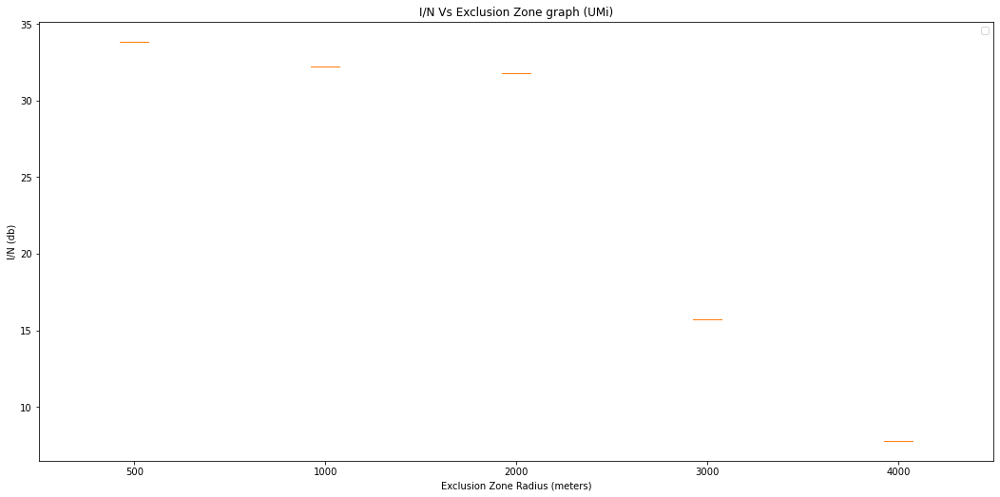

In [31]:
# EXCLUSION ZONE

# Creating dataset
# distance, interface_Noise = pairs_noAverage['UMi']
distance, interface_Noise = pairs['UMi']
 
# print(box_dict_UMi)
 
fig, ax = plt.subplots()

# Creating plot
for i, exclusion_zone in enumerate(exclusion_zones):
    # key is exclusion zone
#     ax.boxplot(interface_Noise[exclusion_zone],
     ax.boxplot([interface_Noise[exclusion_zone]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white'))

# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in exclusion_zones])
 
ax.set_title('I/N Vs Exclusion Zone radius')
ax.set_xlabel('Exclusion Zone Radius (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
#fig.savefig('FSS_8_graphUmiexclusionsum5km.pdf', dpi=100)
plt.show()

In [32]:
pairs['UMi'][1]

{500: 33.850979990131734,
 1000: 32.196584294775604,
 2000: 31.767547496229444,
 3000: 15.693695037848588,
 4000: 7.794497459761183}

In [33]:
pairs_noAverage['UMi'][1]

{500: array([-5.07947817,  3.49517559, -3.21656942, -0.6422721 , -1.02546919,
        -1.21803686, -1.1957749 , -7.01517478,  2.65043479, -5.63549203,
        -3.4098954 ,  6.42244296,  1.31960749, -6.99335709,  1.84750619,
        20.73990745, 13.67135656, 17.29159688,  1.89419945, -6.92215913,
         0.83200626,  6.08200237, -1.21678414, -5.8207021 , -0.34054612,
        -3.80145588, -3.51682947, -3.29592446,  7.6468076 ,  7.6468076 ,
         7.6468076 ,  3.80864279, -1.6894186 , -5.07947817,  3.49517559,
        -3.21656942, -0.6422721 , -1.02546919, -1.21803686, -1.1957749 ,
        -7.01517478,  2.65043479, -5.63549203, -3.4098954 ,  6.42244296,
         1.31960749, -6.99335709,  1.84750619, 20.73990745, 13.67135656,
        17.29159688,  1.89419945, -6.92215913,  0.83200626,  6.08200237,
        -1.21678414, -5.8207021 , -0.34054612, -3.80145588, -3.51682947,
        -3.29592446,  7.6468076 ,  7.6468076 ,  7.6468076 ,  3.80864279,
        -1.6894186 , -5.07947817,  3.49517559,

2022-11-12 10:30:27,206 [Geometry3D WARNING] No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


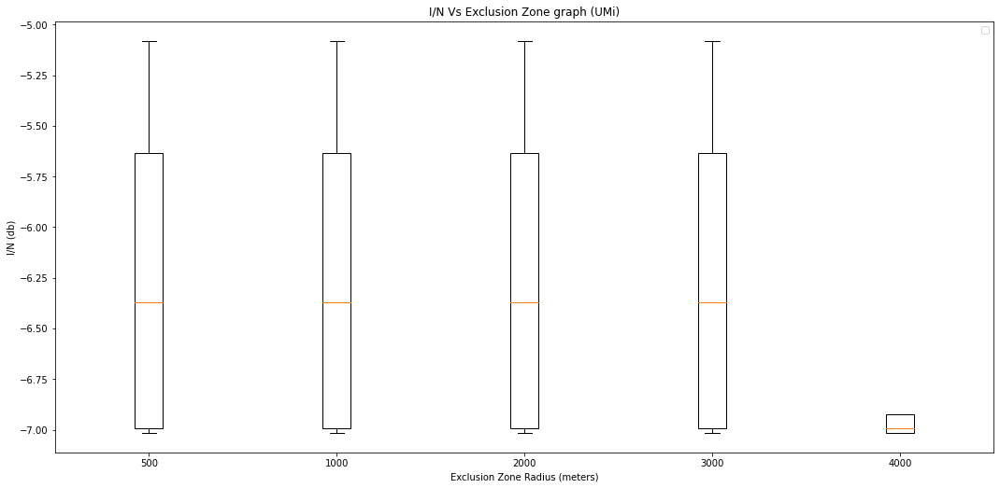

In [34]:
# EXCLUSION ZONE (-15db BS)

# Creating dataset
distance, interface_Noise = pairs_noAverage['UMi']
# distance, interface_Noise = pairs['UMi']
 
# print(box_dict_UMi)
 
fig, ax = plt.subplots()

# Creating plot
for i, exclusion_zone in enumerate(exclusion_zones):
    # key is exclusion zone
#     ax.boxplot(interface_Noise[exclusion_zone],
     ax.boxplot( [x for x in  interface_Noise[exclusion_zone] if x < -5], #(lowest could be -7db)
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white'))

# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in exclusion_zones])
 
ax.set_title('I/N Vs Exclusion Zone graph (UMi)')
ax.set_xlabel('Exclusion Zone Radius (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('FSS_8_-15db_aggregate_omni_graphUmiexclusion5km.pdf', dpi=100)
plt.show()

In [35]:
pairs_noAverage['UMi'] [1]

{500: array([-5.07947817,  3.49517559, -3.21656942, -0.6422721 , -1.02546919,
        -1.21803686, -1.1957749 , -7.01517478,  2.65043479, -5.63549203,
        -3.4098954 ,  6.42244296,  1.31960749, -6.99335709,  1.84750619,
        20.73990745, 13.67135656, 17.29159688,  1.89419945, -6.92215913,
         0.83200626,  6.08200237, -1.21678414, -5.8207021 , -0.34054612,
        -3.80145588, -3.51682947, -3.29592446,  7.6468076 ,  7.6468076 ,
         7.6468076 ,  3.80864279, -1.6894186 , -5.07947817,  3.49517559,
        -3.21656942, -0.6422721 , -1.02546919, -1.21803686, -1.1957749 ,
        -7.01517478,  2.65043479, -5.63549203, -3.4098954 ,  6.42244296,
         1.31960749, -6.99335709,  1.84750619, 20.73990745, 13.67135656,
        17.29159688,  1.89419945, -6.92215913,  0.83200626,  6.08200237,
        -1.21678414, -5.8207021 , -0.34054612, -3.80145588, -3.51682947,
        -3.29592446,  7.6468076 ,  7.6468076 ,  7.6468076 ,  3.80864279,
        -1.6894186 , -5.07947817,  3.49517559,

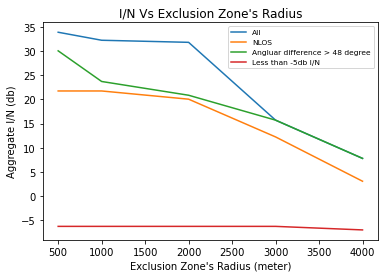

In [11]:
#Combined grpah 

NLOS= {500: 21.72194873003219,
 1000: 21.72194873003219,
 2000: 20.02553558025167,
 3000: 12.229627356762132,
 4000: 3.0778408689863563}


Higher_48={500: 30.00996434379617,
 1000: 23.681407597233665,
 2000: 20.838980211534327,
 3000: 15.693695037848588,
 4000: 7.794497459761183}

all_BS= {500: 33.850979990131734,
 1000: 32.196584294775604,
 2000: 31.767547496229444,
 3000: 15.693695037848588,
 4000: 7.794497459761183}

Neg_5dB = {500: -6.244393884586572, 1000: -6.244393884586572, 2000: -6.244393884586572, 3000: -6.244393884586572, 4000: -6.976897001211328}

exclusion_zones = [500, 1000, 2000, 3000, 4000]

plt.plot(exclusion_zones, [all_BS[ex_z] for ex_z in exclusion_zones], label='All')
plt.plot(exclusion_zones, [NLOS[ex_z] for ex_z in exclusion_zones], label='NLOS')
plt.plot(exclusion_zones, [Higher_48[ex_z] for ex_z in exclusion_zones], label='Angluar difference > 48 degree')
plt.plot(exclusion_zones, [Neg_5dB [ex_z] for ex_z in exclusion_zones] , label='Less than -5db I/N')


plt.xlabel("Exclusion Zone's Radius (meter)")
plt.ylabel('Aggregate I/N (db)')
plt.title("I/N Vs Exclusion Zone's Radius")
plt.legend(fontsize=7.5)
plt.savefig('FSS_15_all_4_together_omni_graphUmiexclusion5km.pdf', dpi=100)
# plt.show()

In [37]:
Neg_5dB = {ex_z: np.mean(np.array([x for x in pairs_noAverage['UMi'][1][ex_z] if x < -5])) for ex_z in pairs_noAverage['UMi'][1] if ex_z > 10}
print(Neg_5dB)

{500: -6.244393884586572, 1000: -6.244393884586572, 2000: -6.244393884586572, 3000: -6.244393884586572, 4000: -6.976897001211328}


In [38]:
len([x for x in pairs_noAverage['UMi'][1][500] if x < -5])/10

6.0

In [39]:
len(pairs_noAverage['UMi'][1])

6

In [40]:
# # Creating dataset
# box_dict_UMi = dict{2: I_N_UMi for 2000, 5: I_N_UMi for 5000, 10: I_N_UMi for 10000}
# distance, interface_Noise = pairs_noAverage['UMi']
# for i in range(len(interface_Noise)):
#     if not line_of_sight[i]:
#         continue   
#     if distance[i] not in box_dict_UMi:
#         box_dict_UMi[distance[i]] = []
#     box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# # print(box_dict_UMi)

# fig, ax= plt.subplots()
 
# # Creating plot
# keys = sorted([key for key in box_dict_UMi])
# for i, key in enumerate(keys):
#     # key is distance
#     # print(key)
#     # print(box_dict_UMi[key])
#     line_of_sight1 = box_dict_UMi[key][0][1]
#     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='blue' if line_of_sight1  else 'red'))
    
# #     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
# #                patch_artist=True,
# #                positions=[i],
# #                boxprops=dict(facecolor='white', color='red' if not line_of_sight1))
                
# # keys = sorted([key for key in box_dict_UMi])
# # ax.boxplot([box_dict_UMi[key] for key in keys])
# ax.set_xticklabels([int(i) for i in keys])

# ax.set_title('I/N Vs Distance graph (UMi LOS)')
# ax.set_xlabel('Distnace of Each BS from FSS (meters)')
# ax.set_ylabel('I/N (db)')
# ax.legend()
 
# # show plot
# # plt.show()
# fig.set_size_inches(18, 8.5)
# # fig.savefig('graphUmiomniwithlog10.pdf', dpi=100)
# plt.show()





In [41]:
# Creating dataset
box_dict_UMi = dict()
distance, interface_Noise = pairs_noAverage['UMi']
for i in range(len(interface_Noise)):
    if line_of_sight[i]:
        continue
        
    if distance[i] not in box_dict_UMi:
        box_dict_UMi[distance[i]] = []
    box_dict_UMi[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMi])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMi[key][0][1]
#     ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
#                patch_artist=True,
#                positions=[i],
#                boxprops=dict(facecolor='white', color='blue' if line_of_sight1))
    
    ax.boxplot([I_N for I_N, los in box_dict_UMi[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='red' if not line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMi NLOS)')
ax.set_xlabel('Distnace of Each BS from FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()

 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUmiomniwithlog10.pdf', dpi=100)
plt.show()
    

KeyError: 2

In [ ]:
# Creating dataset
box_dict_UMa = dict()
distance, interface_Noise = pairs_noAverage['UMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_UMa:
        box_dict_UMa[distance[i]] = []
    box_dict_UMa[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_UMa])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_UMa[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_UMa[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (UMa)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphUMa.pdf', dpi=100)
plt.show()

In [ ]:
# Creating dataset
box_dict_RMa = dict()
distance, interface_Noise = pairs_noAverage['RMa']
for i in range(len(interface_Noise)):
    if distance[i] not in box_dict_RMa:
        box_dict_RMa[distance[i]] = []
    box_dict_RMa[distance[i]].append([interface_Noise[i],line_of_sight[i]])

# print(box_dict_UMi)

fig, ax= plt.subplots()
 
# Creating plot
keys = sorted([key for key in box_dict_RMa])
for i, key in enumerate(keys):
    # key is distance
    # print(key)
    # print(box_dict_UMi[key])
    line_of_sight1 = box_dict_RMa[key][0][1]
    ax.boxplot([I_N for I_N, los in box_dict_RMa[key]],
               patch_artist=True,
               positions=[i],
               boxprops=dict(facecolor='white', color='blue' if line_of_sight1 else 'red'))
                
# keys = sorted([key for key in box_dict_UMi])
# ax.boxplot([box_dict_UMi[key] for key in keys])
ax.set_xticklabels([int(i) for i in keys])

ax.set_title('I/N Vs Distance graph (RMa)')
ax.set_xlabel('Distnace of Each BS to FSS (meters)')
ax.set_ylabel('I/N (db)')
ax.legend()
 
# show plot
# plt.show()
fig.set_size_inches(18, 8.5)
# fig.savefig('graphRma.pdf', dpi=100)
plt.show()